## $k$-sparse parity grokking
See Barak et al. "Hidden Progress in Deep Learning: SGD Learns Parities Near the Computational Limit"


## Setup

In [1]:
import torch
from torch import nn
from torch.nn import functional as F
from torch import optim
import numpy as np
from matplotlib import pyplot as plt
from torch.utils.data import DataLoader, TensorDataset
from tqdm.notebook import tqdm
from copy import deepcopy
import inspect
from itertools import product
from inspect import signature
from pprint import pprint
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from textwrap import wrap
from itertools import product
from ipywidgets import widgets
import os
import pickle
# from frozendict import frozendict     # CAREFUL: hash(frozenset) are not deterministic between runtimes!
import shutil
import hashlib
import pandas as pd
import re

In [2]:
from google.colab import output
output.enable_custom_widget_manager()

In [3]:
from google.colab import drive
drive.mount('/content/drive')
prefix = '/content/drive/MyDrive/MATS/'

Mounted at /content/drive


In [4]:
device = "cuda" if torch.cuda.is_available() else "cpu"

In [5]:
!pip install devinterp
from devinterp.slt import sample, LLCEstimator, OnlineLLCEstimator
from devinterp.optim import SGLD
from devinterp.utils import optimal_temperature

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 43.2/43.2 kB 4.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.3/8.3 MB 66.7 MB/s eta 0:00:00
  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (23.7 MB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (823 kB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (14.1 MB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl (731.7 MB)
  Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl (410.6 MB)
  Using cached nvidia_cufft_cu12-11.0.2.54-py3-none-manylinux1_x86_64.whl (121.6 MB)
  Using cached nvidia_curand_cu12-10.3.2.106-py3-none-manylinux1_x86_64.whl (56.5 MB)
  Using cached nvidia_cusolver_cu12-11.4.5.107-py3-none-manylinux1_x86_64.whl (124.2 MB)
  Using cached nvidia_cusparse_cu12-12.1.0.106-py3-none-manylinux1_x86_64.whl (196.0 MB)
  Using cached nvidia_nccl_cu12-2.20.5-py3-none-manylinux2

In [6]:
import warnings
warnings.filterwarnings("ignore")

## Core functions

### basic utils

In [7]:
def call_with(func, **kwargs):
  sig = inspect.signature(func)
  filtered_kwargs = {k: v for k, v in kwargs.items() if k in sig.parameters}
  return func(**filtered_kwargs)

In [8]:
class dotdict(dict):
    __getattr__ = dict.__getitem__
    __setattr__ = dict.__setitem__
    __delattr__ = dict.__delitem__


In [9]:
def ema(data, hl):
  '''
  returns both ema and variance
  '''
  alpha = 1 - np.exp(np.log(0.5) / hl)
  data = np.array(data)
  n = len(data)

  # Initialize the moving variance and mean
  moving_var = np.zeros(n)
  moving_mean = np.zeros(n)

  # Set initial values
  moving_var[0] = 0
  moving_mean[0] = data[0]

  # Compute exponential moving variance
  for t in range(1, n):
    # Update moving mean
    moving_mean[t] = alpha * data[t] + (1 - alpha) * moving_mean[t-1]

    # Compute variance
    diff = data[t] - moving_mean[t]
    moving_var[t] = alpha * diff**2 + (1 - alpha) * moving_var[t-1]

  return moving_mean, moving_var

In [10]:
def get_anomalies(l, delta=0.5, hl=1, to_add=150):
  ema_l = ema(l, hl)[0]
  score = [abs(l[i] - ema_l[i]) / (abs(ema_l[i])+1e-8) for i in range(len(l))]
  idxs = [i for i in range(len(l)) if score[i] > delta]
  if not to_add:
    return idxs
  else:
    idxs = sorted(idxs, key=lambda i: score[i])
    return list(sorted(idxs[:to_add]))
  return [i for i in range(len(l)) if abs(l[i] - ema_l[i]) / abs(ema_l[i]) > delta]

In [11]:
def hinge_loss(x, y):
  if len(y.shape) == 1:
    y = y.reshape((-1, 1))
  return torch.clamp(1 - y * x, min=0).mean()

In [12]:
def acc(x, y):
  if x.shape[-1] == 2:
    # cross entropy case
    return (torch.argmax(x, dim=-1) == y).float().mean().item()
  else:
    # hinge or MSE case
    if len(y.shape) == 1:
      y = y.reshape((-1, 1))
    if (x > -0.1).all():
      # this is pretty hacky. if inputs are {0, 1}, convert to {\pm 1}.
      x = 2 * x - 1
      y = 2 * x - 1
    return (torch.sign(x) == torch.sign(y)).float().mean().item()

In [13]:
def detect_domain(l, cond):
  idxs = []
  for i, x in enumerate(l):
    if cond(x):
      idxs.append(i)
  return idxs

In [14]:
def get_param_str(params, sep='_'):
  return sep.join(f'{k}={v}' for k, v in params.items())

In [15]:
# normalized norms
def l1(x):
  return torch.norm(x, p=1).item() / x.numel()
def l2(x):
  return torch.norm(x, p='fro').item() / np.sqrt(x.numel())

### checkpoints store

In [16]:
IGNORE_PARAMS = [
    'tq', 'save_ckpts', 'anom_delta', 'anom_hl', 'llc_stride',
    'test_stride', 'populators', 'force_regen',
]

In [17]:
def det_hash(d):
  '''
  Deterministic hash of dict d.
  '''
  if any (not isinstance(k, str) for k in d):
    raise ValueError('keys must be strings')
  d = sorted(frozenset(d.items()), key=lambda x: x[0])
  return hashlib.md5(str.encode(str(d))).hexdigest()

In [18]:
def clean_params(params):
  return {k: v for k, v in params.items() if k not in IGNORE_PARAMS}

In [19]:
CKPTS_STORE = f'{prefix}/ksparse/ckpts'
def store_ckpts(ckpts, params, overwrite=False):
  params = clean_params(params)
  dir = f'{CKPTS_STORE}/{det_hash(params)}/'
  if os.path.exists(dir):
    if overwrite:
      print(f'{dir} already exists! Overwriting!')
    else:
      print(f'{dir} already exists! Skipping!')
      return
  os.makedirs(dir, exist_ok=overwrite)
  print('Saving ckpts to', dir)
  torch.save(ckpts, f'{dir}/ckpts.pt')
  torch.save(dict(params), f'{dir}/params.pt')

In [20]:
def load_ckpts(params):
  params = clean_params(params)
  dir = f'{CKPTS_STORE}/{det_hash(params)}/'
  if os.path.exists(dir):
    print('Loading ckpts from', dir)
    return torch.load(f'{dir}/ckpts.pt'), dict(torch.load(f'{dir}/params.pt'))
  else:
    print(f'No ckpts found at {dir}')
    return None

In [21]:
def show_ckpts(id):
  dir = f'{CKPTS_STORE}/{id}/'
  if os.path.exists(dir):
    print(dir)
    pprint(dict(torch.load(f'{dir}/params.pt')))
  else:
    print(f'{dir} does not exist!')

In [22]:
def show_ckpts_all():
  for id in os.listdir(CKPTS_STORE):
    show_ckpts(id)
    print()

In [23]:
def clean_ckpts():
  for id in os.listdir(CKPTS_STORE):
    params = torch.load(f'{CKPTS_STORE}/{id}/params.pt')
    params = clean_params(params)
    if id == det_hash(params):
      continue
    print('Cleaning up ckpt', id)
    ckpts = torch.load(f'{CKPTS_STORE}/{id}/ckpts.pt')
    shutil.rmtree(f'{CKPTS_STORE}/{id}')
    store_ckpts(ckpts, params)

### model

In [24]:
class FCNet(nn.Module):
  def __init__(self, dims, act=F.relu, init_scale=1.0, generator=None):
    super().__init__()

    self.dims = dims
    self.act = act

    self.layers = nn.ModuleList()
    for i in range(len(dims)-1):
      layer = nn.Linear(dims[i], dims[i+1], device=device)

      # copied from nn.Linear.reset_parameters()
      # but using generator for reproducibility
      nn.init.kaiming_uniform_(layer.weight, a=np.sqrt(5), generator=generator)
      fan_in, _ = nn.init._calculate_fan_in_and_fan_out(layer.weight)
      bound = 1 / np.sqrt(fan_in) if fan_in > 0 else 0
      nn.init.uniform_(layer.bias, -bound, bound, generator=generator)

      # larger weight initializations promote slower grokking (?)
      layer.weight.data *= init_scale
      layer.bias.data *= init_scale
      self.layers.append(layer)

  def forward(self, x, output_acts=False):
    ret = dotdict()
    acts = [x]
    pre_acts = []
    for layer in self.layers[:-1]:
      pre_acts.append(layer(acts[-1]))
      acts.append(self.act(pre_acts[-1]))
    pre_acts.append(self.layers[-1](acts[-1]))
    if output_acts:
      ret.pre_acts = pre_acts
      ret.acts = acts
      ret.logits = pre_acts[-1]
      return ret
    else:
      return pre_acts[-1]

### dataset

In [25]:
def ksparse_dataset(samples, n, k, batch_size=64, inds=None, ce=True, generator=None):
  x = torch.randint(0, 2, size=(samples, n), device=device, generator=generator)
  mask = torch.zeros(size=(1, n), device=device)
  if inds is None:
    inds = list(range(k))
  mask[0, inds] = 1
  y = (x * mask).sum(dim=1) % 2
  x = x.float()
  y = y.long()
  # for cross entropy, we want outputs in {0, 1} and y is long and 1-D
  # for hinge loss, we want {\pm 1} and y is float and 2-D
  if not ce:
    x = 2 * x - 1
    y = 2 * y - 1
    y = y.float()
    y = y.reshape((-1, 1))
  data = TensorDataset(x, y)
  return data

### train/test loops

In [26]:
def cos(x, y):
  if x.norm() == 0 or y.norm() == 0:
    return 0
  return (x * y).sum() / (x.norm() * y.norm())

In [85]:
def margin(logits, y):
  true = logits.gather(dim=1, index=y.reshape((-1, 1)))
  other = logits.clone()
  other.scatter_(dim=1, index=y.reshape((-1, 1)), src=torch.ones_like(logits)*-10000)
  other = torch.max(other, dim=1).values
  return torch.min(true.flatten() - other.flatten()).item()

In [87]:
def train_epoch(model, loader, optimizer, loss_fn, ret_ckpts=True):
  model.train()
  train_loss = 0
  train_acc = 0
  ckpts = []
  for i, (x, y) in enumerate(loader):
    optimizer.zero_grad()
    out = model(x, output_acts=True)
    loss = loss_fn(out.logits, y)
    train_loss += loss.item()
    train_acc += acc(out.logits, y)
    ckpts.append(
        dotdict({
            'model': deepcopy(model.state_dict()),
            'pre_acts': out.pre_acts,
            'acts': out.acts,
            'train_loss': loss.item(),
            'train_x': x,
            'train_y': y,
            'train_logits': out.logits,
            'iter': i,
            'margin': margin(out.logits, y),
        })
    )
    step = dict()
    step_cos = dict()
    prev_model = ckpts[-2]['model'] if len(ckpts) > 1 else ckpts[-1]['model']
    for k in prev_model:
      step[k] = (ckpts[-1]['model'][k] - prev_model[k]).detach()
      step_cos[k] = cos(step[k], prev_model[k])
    ckpts[-1]['step'] = step
    ckpts[-1]['step_cos'] = step
    loss.backward()
    ckpts[-1]['grads'] = dict()
    for name, param in model.named_parameters():
      ckpts[-1]['grads'][name] = param.grad.data.clone().detach()
    optimizer.step()
    optim_state = dict()
    for i, (name, param) in enumerate(model.named_parameters()):
      optim_state[name] = deepcopy(optimizer.state_dict()['state'][i])
    ckpts[-1]['optim_state'] = optim_state
  ret = dotdict()
  ret.train_loss = train_loss / len(loader)
  ret.train_acc = train_acc / len(loader)
  if ret_ckpts:
    ret.ckpts = ckpts
  return ret

In [29]:
def test_epoch(model, loader, loss_fn):
  test_loss = 0
  test_acc = 0
  model.eval()
  with torch.no_grad():
    for x, y in (loader):
      out = model(x, output_acts=True)
      loss = loss_fn(out.logits, y)
      test_loss += loss.item()
      test_acc += acc(out.logits, y)
  return dotdict({
      'test_loss': test_loss / len(loader),
      'test_acc': test_acc / len(loader)
  })

### llc estimation

In [30]:
def llc_from_trace(trace, beta, init_loss=None, warmup=0.5, burnin=0.5):
  # trace is (num_chains, num_draws)
  if warmup > 0:
    warmup_steps = int(warmup * trace.shape[1])
    init_loss = trace[:, :warmup_steps].min(axis=1)
  else:
    assert init_loss is not None
  burnin_steps = int(burnin * trace.shape[1])
  avg_loss = trace[:,burnin_steps:].mean(axis=1)
  return (avg_loss - init_loss).mean().item() * beta

In [31]:
def sgld_trace(
    model, loader, epochs, loss_fn=hinge_loss,
    eps=1e-3, beta=1_000., gamma=1., tq=False,
    generator=None, orig_params=None
):
  if not generator:
    generator = torch.Generator(device=device)
  model = deepcopy(model)    # copy to avoid changing model params
  if not orig_params:
    orig_params = {}
    for name, param in model.named_parameters():
      orig_params[name] = param.data.clone().detach()

  trace = []
  for epoch in range(epochs):
    for x, y in loader:
      out = model(x)
      loss = loss_fn(out, y)
      trace.append(loss)
      loss.backward()
      for name, param in model.named_parameters():
          grad = param.grad.DataFrame
          param.data.add_(
            -(eps / 2) * beta * param.grad.data
            + (eps / 2) * gamma * (orig_params[name] - param)
            + torch.normal(0, np.sqrt(eps), size=param.data.shape, generator=generator, device=device)
          )
  return trace


In [32]:
# def estimate_llc(
#     model, loader, epochs, loss_fn=hinge_loss,
#     eps=1e-3, beta=1_000., gamma=1., tq=False,
#     generator=None, orig_params=None,
#     num_chains=5, warmup=0.2, burnin=0.5,
# ):
#   pass

In [33]:
# Our own implementation of the SGLD LLC estimator.
# But it's (probably?) better to just use the one in timaeus-research/devinterp
# This is messy + not very efficient. Re-implement...
def estimate_llc(
    model, loader, epochs, loss_fn=hinge_loss, #loss_fn=nn.CrossEntropyLoss(),
    eps=1e-3, beta=1_000., gamma=1., tq=False, ortho_grad=True,
    generator=None, num_chains=5, burnin=0.5, warmup=0.05
):
  # We reparameterize so that our beta is Lau et al's beta*n
  if not generator:
    generator = torch.Generator(device=device)
  all_traces = []
  all_losses = []
  all_orig_losses = []
  all_paths = []
  orig_model = deepcopy(model)
  if ortho_grad:
    orig_model.eval()
  else:
    orig_model.train()
  warmup_epochs = int(warmup * epochs)
  for _ in range(num_chains):
    model = deepcopy(orig_model)   # copy so that we don't change the original weights
    trace, losses, orig_losses, path = [], [], [], []
    model.train()
    it = tqdm(range(epochs)) if tq else range(epochs)
    warm_model = deepcopy(orig_model)
    warmup_done = False
    for i, epoch in enumerate(it):
      if i > warmup_epochs and not warmup_done:
        # to avoid negative llcs
        # we first run for warmup_epochs and set warmup_model to whatever is reached
        # then subtract warm_model's loss instead of orig_model
        warm_model = deepcopy(model)
        trace, losses, orig_losses, path = [], [], [], []
        warmup_done = True
      for x, y in loader:
        out = model(x)
        loss = loss_fn(out, y)
        orig_out = warm_model(x)
        orig_loss = loss_fn(orig_out, y)
        trace.append(beta * (loss - orig_loss).item())
        loss.backward()
        if ortho_grad:
          orig_loss.backward()
        losses.append(loss.item())
        orig_losses.append(orig_loss.item())

        cur_params = dict()
        for name, param in model.named_parameters():
          # import pdb; pdb.set_trace()
          orig_param = warm_model.get_parameter(name)
          grad = param.grad.data
          if ortho_grad:
            orig_grad = orig_param.grad.data
            grad = grad - orig_grad * (grad * orig_grad).sum(dim=-1, keepdims=True) / (orig_grad * orig_grad).sum(dim=-1, keepdims=True)
          param.data += -(eps / 2) * beta * param.grad.data \
            + (eps / 2) * gamma * (orig_param - param)
          if warmup_done:  # only add noise after done warming up (?)
            param.data += torch.normal(0, np.sqrt(eps), size=param.data.shape, generator=generator, device=device)
          param.grad.data.zero_()
          if ortho_grad:
            orig_param.grad.data.zero_()
          cur_params[name] = param.data.clone().detach()
        path.append(cur_params)
    all_traces.append(trace)
    all_losses.append(losses)
    all_orig_losses.append(orig_losses)
    all_paths.append(path)
  llc = np.mean(np.array(all_traces)[:,int(burnin * len(all_traces[0])):])
  return dotdict({
      'llc': llc,
      'all_traces': all_traces,
      'all_losses': all_losses,
      'all_orig_losses': all_orig_losses,
      'all_paths': all_paths,
  })

### stats populators

In [34]:
def populate_test(model, ckpt, test_loader, loss_fn):
  model.load_state_dict(ckpt['model'])
  if 'test_loss' in ckpt:
    return ckpt
  test_out = test_epoch(model, test_loader, loss_fn=loss_fn)
  ckpt.update(test_out)
  return ckpt

In [35]:
def populate_llc(
  model, ckpt,
  llc_epochs, llc_loader, num_chains, loss_fn, llc_seed,
  beta, eps, gamma,
  warmup, burnin,
):
  model.load_state_dict(ckpt['model'])
  if 'llc' in ckpt:
    return ckpt
  num_draws = llc_epochs * len(llc_loader)
  llc_estimator = LLCEstimator(
    num_chains=num_chains, num_draws=num_draws,
    temperature=beta,
  )
  optim_kwargs = {
      'lr': eps,
      'localization': gamma,
      'temperature': beta,
  }
  # We only use sample to get the loss trace
  # Then compute llc ourselves
  sample(
      model, llc_loader,
      criterion=nn.CrossEntropyLoss(),
      optimizer_kwargs=optim_kwargs,
      num_chains=num_chains,
      num_draws=num_draws,
      num_burnin_steps=0,
      callbacks=[llc_estimator],
      device=device,
      sampling_method=SGLD,
      verbose=False,
      seed=llc_seed,
  )
  ckpt.update(llc_estimator.sample())
  if warmup > 0:
    ckpt['llc'] = llc_from_trace(ckpt['loss/trace'], beta, warmup=warmup, burnin=burnin)
  else:
    init_loss = test_epoch(model, llc_loader, loss_fn=loss_fn).test_loss
    ckpt['llc'] = llc_from_trace(ckpt['loss/trace'], beta, warmup=warmup, init_loss=init_loss)
  return ckpt

In [36]:
def populate_norm(ckpt):
  # Need to handle depth>1 dicts..
  def _populate(d, keys):
    if not keys:
      keys = d.keys()
    for k in keys:
      if k not in d:
        continue
      if isinstance(d[k], list):
        d[k] = dict(enumerate(d[k]))
      if isinstance(d[k], dict):
        _populate(d[k], list(d[k].keys()))
      if isinstance(d[k], torch.Tensor) and d[k].numel() > 1:
          d[f'{k}/l1_norm'] = l1(d[k])
          d[f'{k}/l2_norm'] = l2(d[k])

  keys = ['model', 'pre_acts', 'acts', 'grads', 'optim_state']
  _populate(ckpt, keys)
  return ckpt

In [37]:
# def populate_weight(ckpt):
#   l1_total = 0
#   l2_total = 0
#   numel_total = 0
#   if 'total_norm_1' in ckpt and 'total_norm_2':
#     return ckpt
#   for name, param in ckpt['model'].items():
#     l1 = torch.norm(param, p=1).item()
#     l2 = torch.norm(param, p='fro').item()
#     numel = param.numel()
#     l1_total += l1
#     l2_total += l2
#     numel_total += numel
#     ckpt[f'{name}/total_norm_1'] = l1 / numel
#     ckpt[f'{name}/total_norm_2'] = l2 / np.sqrt(numel)
#   ckpt[f'total_norm_1'] = l1_total / numel_total
#   ckpt[f'total_norm_2'] = l2_total / np.sqrt(numel_total)
#   return ckpt

### runner

In [38]:
OPTIM_DICT = {
    'SGD': optim.SGD,
    'Adam': optim.Adam,
    'AdamW': optim.AdamW,
}

LOSS_DICT = {
    'hinge': hinge_loss,
    'cross_entropy': nn.CrossEntropyLoss(),
    'MSE': nn.MSELoss(),
}

In [39]:
class Runner():
  '''
  Mostly responsible just for holding onto the params and frequently used objects.
  By convention, __init__(...) gets params that should be saved with the ckpts
  (model/data/llc hyperparams, etc)
  while run(...) gets params that don't need to be saved (stride, anom stuff, etc)
  '''
  # TODO: make this more generic (arbitrary callables instead of just TEST and LLC)
  # Probably train loop will need to remain hardcoded (depends on past state)
  def __init__(
    self,
    # TASK
    n=40,
    k=3,
    # MODEL
    width=128,
    depth=1,
    # TRAIN
    init_scale=3.0,
    train_size=600,
    batch_size=32,
    train_epochs=500,
    lr=1e-2,
    decay=0.1, #5e-3,
    optim_name='AdamW',
    loss_name='cross_entropy',
    train_seed=105,
    optim_beta1=0.9,
    optim_beta2=0.999,
    optim_eps=1e-8,
    # TEST
    test_size=1024,
    # LLC
    eps=1e-4,
    beta=100,
    gamma=1.,
    num_chains=5,
    llc_epochs=500,
    llc_seed=42,
    warmup=0.5,
    burnin=0.8,
    # misc
    ckpt_lite=False,
  ):
    args = vars()
    for param in list(signature(Runner.__init__).parameters):
      setattr(self, param, args[param])
    self.setup()

  def get_params(self):
    ret = {}
    for param in list(signature(Runner.__init__).parameters):
      ret[param] = getattr(self, param)
    del ret['self']
    return ret

  def setup(self):
    # This is annoying -- generator must be on cpu for Dataloader shuffle
    # But but should be on device for everything else
    # So we have two...
    train_loader_gen = torch.Generator(device='cpu')
    train_gen = torch.Generator(device=device)
    if self.train_seed is not None:
      train_loader_gen.manual_seed(self.train_seed)
      train_gen.manual_seed(self.train_seed)

    llc_loader_gen = torch.Generator(device='cpu')
    # llc_gen = torch.Generator(device=device)
    # if llc_seed is not None:
    #   llc_loader_gen.manual_seed(llc_seed)
    #   llc_gen.manual_seed(llc_seed)

    ce = self.loss_name == 'cross_entropy'
    self.train_set = ksparse_dataset(self.train_size, self.n, self.k, ce=ce, generator=train_gen)
    self.train_loader = DataLoader(self.train_set, batch_size=self.batch_size, shuffle=True, generator=train_loader_gen)
    self.test_set = ksparse_dataset(self.test_size, self.n, self.k, ce=ce, generator=train_gen)
    self.test_loader = DataLoader(self.test_set, batch_size=self.test_size, shuffle=False)
    self.llc_loader = DataLoader(self.train_set, batch_size=self.train_size, shuffle=True, generator=llc_loader_gen)

    self.model = FCNet(
        dims=[self.n] + [self.width] * self.depth + [2 if ce else 1],
        init_scale=self.init_scale,
        generator=train_gen,
    )
    self.loss_fn = LOSS_DICT[self.loss_name]
    self.optimizer = OPTIM_DICT[self.optim_name](
        self.model.parameters(), lr=self.lr, weight_decay=self.decay,
        betas=(self.optim_beta1, self.optim_beta2), eps=self.optim_eps,
    )

  def get_itr(self, ckpts, stride, name, tq, anom_delta, anom_hl, train_losses=None):
    if stride is None:
      return []
    itr = set(range(0, len(ckpts), stride))
    # It'd be nice to detect test loss anomalies here too, when populating LLC
    # But the inconsistent stride on test_loss makes that difficult..
    # (ema isn't aware of differing time intervals)
    if stride > 1 and train_losses is not None:
      itr |= set(get_anomalies(train_losses, delta=anom_delta, hl=anom_hl))
      itr = sorted(itr)
    if tq:
      itr = tqdm(itr)
      itr.set_description(name)
    return itr

  def run(
      self, tq=True, save_ckpts=True, norm_stride=1,
      test_stride=10, llc_stride=100,
      force_regen=False, anom_delta=0.5, anom_hl=5,
    ):
    loaded_ckpts = False
    ckpts = load_ckpts(self.__dir__) if not force_regen else None
    if ckpts:
      print('Loaded ckpts from cache!')
      ckpts = ckpts[0]
      loaded_ckpts = True

    # TRAIN LOOP
    if not loaded_ckpts:
      ckpts = []
      itr = range(self.train_epochs)
      if tq:
        itr = tqdm(itr)
        itr.set_description('TRAIN')
      for epoch in itr:
        train_out = train_epoch(
            self.model, self.train_loader, self.optimizer,
            loss_fn=self.loss_fn, ret_ckpts=True
        )
        epoch_ckpts = train_out.ckpts
        for ckpt in epoch_ckpts:
          ckpt['epoch'] = epoch
        ckpts.extend(epoch_ckpts)

    train_losses = [ckpt.train_loss for ckpt in ckpts]

    # NORM LOOP
    # itr = self.get_itr(
    #   ckpts=ckpts,
    #   stride=norm_stride,
    #   name='NORM',
    #   tq=tq,
    #   anom_delta=anom_delta,
    #   anom_hl=anom_hl,
    #   train_losses=train_losses,
    # )
    # for i in itr:
    #   populate_norm(ckpts[i])

    # TEST LOOP
    itr = self.get_itr(
      ckpts=ckpts,
      stride=test_stride,
      name='TEST',
      tq=tq,
      anom_delta=anom_delta,
      anom_hl=anom_hl,
      train_losses=train_losses,
    )
    for i in itr:
      populate_test(self.model, ckpts[i], test_loader=self.test_loader, loss_fn=self.loss_fn)

    # LLC LOOP
    itr = self.get_itr(
      ckpts=ckpts,
      stride=llc_stride,
      name='LLC',
      tq=tq,
      anom_delta=anom_delta,
      anom_hl=anom_hl,
      train_losses=train_losses,
    )
    for i in itr:
      populate_llc(
        self.model, ckpts[i],
        llc_epochs=self.llc_epochs,
        llc_loader=self.llc_loader,
        num_chains=self.num_chains,
        loss_fn=self.loss_fn,
        llc_seed=self.llc_seed,
        beta=self.beta, eps=self.eps, gamma=self.gamma,
        warmup=self.warmup, burnin=self.burnin,
      )
    heavy = [
        'model', 'pre_acts', 'acts',
        'optimizer', 'grads', 'loss/trace', 'llc-chain/*',
        'train_logits', 'train_x', 'train_y',
    ]
    if self.ckpt_lite:
      for pattern in heavy:
        p = re.compile(f'^{pattern}$')
        for ckpt in ckpts:
          for k in list(ckpt.keys()):
            if p.match(k):
              ckpt.pop(k)
    if save_ckpts and not loaded_ckpts:
      store_ckpts(ckpts, self.get_params())
    self.ckpts = ckpts
    return ckpts

### plot

In [40]:
# pyplot version
# def plot_ckpts(
#     ckpts, ckpt_slice=None, x1scale='linear', x2scale='linear', yscale='linear', ax=None,
# ):
#   if not ax:
#     ax = plt.gca()
#   if ckpt_slice:
#     ckpts = ckpts[ckpt_slice]

#   # automatically stride from which ckpts have test and llc
#   test_domain = detect_domain(ckpts, lambda ckpt: 'test_loss' in ckpt)

#   ax1 = ax
#   ax2 = ax1.twinx()

#   lines = []
#   lines.append(ax1.plot([ckpt.train_loss for ckpt in ckpts], label='train_loss', c='b'))
#   lines.append(
#       ax1.plot(test_domain, [ckpts[i].test_loss for i in test_domain], label='test_loss', c='tab:orange')
#   )
#   lines.append(ax2.plot([ckpt.weight_norm for ckpt in ckpts], label='weight_norm', c='g'))
#   ax.set_xscale(x1scale)
#   ax2.set_xscale(x2scale)
#   ax1.set_yscale(yscale)
#   ax1.legend(loc='upper left')
#   ax2.legend(loc='upper right')
#   return lines

In [41]:
def loss_acc_plot(
    train_losses, test_losses, train_accs, test_accs, plot_slice=None, ax=None,
    xscale='linear', yscale='linear',
):
  if not ax:
    ax = plt.gca()
  if not plot_slice:
    plot_slice = slice(0, len(train_losses))
  lines = []
  lines.append(ax.plot(train_losses[plot_slice])[0])
  lines.append(ax.plot(test_losses[plot_slice])[0])
  lines.append(ax.plot(train_accs[plot_slice], alpha=0.5)[0])
  lines.append(ax.plot(test_accs[plot_slice], alpha=0.5)[0])
  ax.set_xscale(xscale)
  ax.set_yscale(yscale)
  return lines
  # plt.xscale('log')
  # plt.show()

In [42]:
def plot_loss_llc(ckpts, supfig=None, row=1, col=1, subtitle=None):
  fig = supfig if supfig else make_subplots()
  x = detect_domain(ckpts, lambda ckpt: 'test_loss' in ckpt and 'llc' in ckpt)
  test_losses = [ckpts[i].test_loss for i in x]
  llcs = [ckpts[i].llc for i in x]
  fig.add_trace(
      go.Scatter(
        x=test_losses, y=llcs, #mode='markers',
      )
  )
  x_title = 'test loss' + (f' ({subtitle})' if subtitle else '')
  fig.update_xaxes(title_text=x_title, row=row, col=col)
  fig.update_yaxes(title_text='llc', row=row, col=col)
  return fig

In [43]:
def sshot_intervals(ckpts, thresh_low=1e-2, thresh_high = 1e-1):
  i = 0
  while i < len(ckpts) and ckpts[i].train_loss > thresh_low:
    i += 1
  ret = []
  sshot_start = None
  while i < len(ckpts):
    if ckpts[i].train_loss > thresh_high and sshot_start is None:
      sshot_start = i
    if ckpts[i].train_loss < thresh_low and sshot_start is not None:
      ret.append((sshot_start, i))
      sshot_start = None
    i += 1
  return ret

In [44]:
def unpack(d, key, sep=';'):
  key = key.split(sep)
  ret = d
  for k in key:
    if k not in ret:
      return None
    ret = ret[k]
  return ret

In [45]:
def add_params(fig, params, title='k-sparse', x=0.02, y=-0.24, width=200):
  param_str = get_param_str(params, sep=', ')
  fig.update_layout(
    #title_text='k-sparse',
    annotations=[{
        'text': param_str,
        'text': '<br>'.join(wrap(param_str, width=width)),
        'xref': 'paper',
        'yref': 'paper',
        'showarrow': False,
        'x': x, 'y': y,
    }],
  )
  return fig

In [94]:
# plotly version
max_inv_sqrt = lambda x: torch.max(torch.norm(1 / (x + 1e-8))).item()
def plot_ckpts(
  ckpts, ckpt_slice=None, xscale='linear', y1scale='linear',
  y2scale='linear', params=None, supfig=None, row=1, col=1, subtitle=None,
  anom_delta=5.0, anom_hl=10, to_plot=None, #group=False,
):
  # (name, secondary, scale, norm)
  if to_plot is None:
    to_plot = [
      ('train_loss', False, 1, None),
      ('test_loss', False, 1, None),
      ('margin', False, .1, None),
      ('llc', True, 1, None),
    ]
    for k in ckpts[0].model:
      to_plot.append((f'model;{k}', True, 1, l1))
      to_plot.append((f'step;{k}', True, 1, l1))
      to_plot.append((f'step_cos;{k}', True, 1, l1))
      to_plot.append((f'grads;{k}', True, 1, l1))
      to_plot.append((f'optim_state;{k};exp_avg', True, 1, l1))
      to_plot.append((f'optim_state;{k};exp_avg_sq', True, 1, l1))

  if ckpt_slice:
    ckpts = ckpts[ckpt_slice]
  fig = supfig if supfig else make_subplots(specs=[[{'secondary_y': True}]])
  cmap = plt.get_cmap('jet')
  for i, (name, secondary, scale, norm) in enumerate(to_plot):
    color_str = ','.join(map(lambda c: str(int(255*c)), cmap(i/len(to_plot))[:3]))
    x = detect_domain(ckpts, lambda ckpt: unpack(ckpt, name) is not None)
    if not x:
      #print(f'{name} not detected; skipping!')
      continue
    y = [unpack(ckpts[i], name)*scale for i in x]
    label = name if scale==1 else f'{name}*{scale}'
    if isinstance(y[0], torch.Tensor) and y[0].numel() > 1:
      y = [norm(t) for t in y]
    fig.add_trace(
        go.Scatter(
            x=x, y=y, name=label, legendgroup=name,
            showlegend= (row==1 and col==1),
            marker={'color': f'rgb({color_str})'}
        ),
        secondary_y=secondary, row=row, col=col,
    )

  sshots = sshot_intervals(ckpts)
  for x0, x1 in sshots:
    fig.add_vrect(x0=x0, x1=x1, fillcolor='red', opacity=0.2, line_width=0, row=row, col=col)
  x_title = 'iters' + (f' ({subtitle})' if subtitle else '')
  fig.update_xaxes(title_text=x_title, type=xscale, row=row, col=col)
  fig.update_yaxes(title_text='loss', type=y1scale, secondary_y=False, row=row, col=col)
  fig.update_yaxes(title_text='complexity', type=y2scale, secondary_y=True, row=row, col=col)
  if params:
    add_params(fig, params)
  return fig


In [47]:
def plot_sweep(rows, cols, params, tq=False, save_ckpts=False, loss_llc=False):
  nrows = len(rows[1])
  ncols = len(cols[1])
  itr = tqdm(product(enumerate(rows[1]), enumerate(cols[1])), total=nrows * ncols)

  specs = [[{'secondary_y': True} for _ in range(ncols)] for _ in range(nrows)]
  fig = make_subplots(rows=nrows, cols=ncols, specs=specs)
  for (i, row_param), (j, col_param) in itr:
    cur_params = {**params, **{rows[0]: row_param, cols[0]: col_param,}}
    runner = Runner(**cur_params)
    ckpts = runner.run(tq=tq, save_ckpts=save_ckpts)
    subtitle = f'{rows[0]}={row_param:.2e}, {cols[0]}={col_param:.2e}'
    if loss_llc:
      fig = plot_loss_llc(ckpts, supfig=fig, row=i+1, col=j+1, subtitle=subtitle)
    else:
      fig = plot_ckpts(ckpts, supfig=fig, row=i+1, col=j+1, subtitle=subtitle)
  params = {k: v for k, v in params.items() if k not in [rows[0], cols[0]]}
  fig = add_params(fig, params, x=0.02, y=-0.24)
  return fig

## Running things

In [48]:
RUN_PARAMS = {
  'norm_stride': 1,
  'test_stride': 10,
  'llc_stride': None,#100,
  'anom_delta': 0.5,
  'anom_hl': 5,
  'save_ckpts': False,
  'force_regen': True,
}

In [98]:
runner = Runner(
    decay=0.01,
    train_size=1000,
    # batch_size=2000,
)
ckpts = runner.run(**RUN_PARAMS)

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/1737 [00:00<?, ?it/s]

In [99]:
fig = plot_ckpts(ckpts)
fig.show()

In [ ]:
fig.update_yaxes(type='log', secondary_y=True)
fig.show()

In [ ]:


from collections import defaultdict
step_norms = defaultdict(list)
for i in range(len(ckpts) - 1):
  for k, v in ckpts[i].model.items():
    step_norms[k].append(torch.norm(ckpts[i + 1].model[k] - v, p='fro').item())

In [ ]:
df = pd.DataFrame(step_norms)
fig = px.line(df)
fig.show()

In [ ]:
for seed in range(1, 100):
  print(seed)
  ckpts = run(**{**PARAMS, 'train_seed': seed}, save_ckpts=False, force_regen=True)
  fig = plot_ckpts(ckpts)
  fig.show()

1


  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/1086 [00:00<?, ?it/s]

2


  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/1085 [00:00<?, ?it/s]

3


  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/1033 [00:00<?, ?it/s]

KeyboardInterrupt: 

In [ ]:
#rows = ('optim', ['SGD', 'Adam', 'AdamW'])
#rows = ('loss_name', ['cross_entropy', 'MSE', 'hinge'])
#cols = ('train_size', list(range(600, 2000, 200)))
#rows = ('decay', [0, 1e-4, 1e-3, 5e-3, 1e-2, 1e-1, 1.])
#cols = ('train_size', [500, 600, 700, 800, 1000])
#rows = ('decay', [1e-2, 1e-1])
rows = ('optim_beta1', [0, .5, .9])
cols = ('optim_beta2', [0., .5, .9, .99, .999])
fig = plot_sweep(rows, cols, PARAMS, tq=True, save_ckpts=False)
fig.show()

  0%|          | 0/15 [00:00<?, ?it/s]

No ckpts found at /content/drive/MyDrive/MATS//ksparse/ckpts/501a75b6e91968e124aafb29c307f6ac/


  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/1086 [00:00<?, ?it/s]

  0%|          | 0/1086 [00:00<?, ?it/s]

llc not detected; skipping!
No ckpts found at /content/drive/MyDrive/MATS//ksparse/ckpts/16987d2bf1472ed5378d01223eda2c15/


  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/1081 [00:00<?, ?it/s]

  0%|          | 0/1081 [00:00<?, ?it/s]

llc not detected; skipping!
No ckpts found at /content/drive/MyDrive/MATS//ksparse/ckpts/4b2ba3086abd747826b7215fb073f359/


  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/1085 [00:00<?, ?it/s]

  0%|          | 0/1085 [00:00<?, ?it/s]

llc not detected; skipping!
No ckpts found at /content/drive/MyDrive/MATS//ksparse/ckpts/e470e2f10142e4b271fa344ed9266937/


  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/1087 [00:00<?, ?it/s]

  0%|          | 0/1087 [00:00<?, ?it/s]

llc not detected; skipping!
No ckpts found at /content/drive/MyDrive/MATS//ksparse/ckpts/1ba6783c2c675f3e14f3ca2eb6868c33/


  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/1082 [00:00<?, ?it/s]

  0%|          | 0/1082 [00:00<?, ?it/s]

llc not detected; skipping!
No ckpts found at /content/drive/MyDrive/MATS//ksparse/ckpts/2fd9591d453391ce1e07ff1a2ebed962/


  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/1082 [00:00<?, ?it/s]

  0%|          | 0/1082 [00:00<?, ?it/s]

llc not detected; skipping!
No ckpts found at /content/drive/MyDrive/MATS//ksparse/ckpts/fa7dbf008804345264baa781cadc6c0d/


  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/1086 [00:00<?, ?it/s]

  0%|          | 0/1086 [00:00<?, ?it/s]

llc not detected; skipping!
No ckpts found at /content/drive/MyDrive/MATS//ksparse/ckpts/03457d6f14a210cc0e99bac09b390890/


  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/1029 [00:00<?, ?it/s]

  0%|          | 0/1029 [00:00<?, ?it/s]

llc not detected; skipping!
No ckpts found at /content/drive/MyDrive/MATS//ksparse/ckpts/4074a957275a129f058b46c2e36525ac/


  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/1048 [00:00<?, ?it/s]

  0%|          | 0/1048 [00:00<?, ?it/s]

llc not detected; skipping!
No ckpts found at /content/drive/MyDrive/MATS//ksparse/ckpts/8c7e1a2ed6cf80e98dcaec14280ae8d0/


  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/1014 [00:00<?, ?it/s]

  0%|          | 0/1014 [00:00<?, ?it/s]

llc not detected; skipping!
No ckpts found at /content/drive/MyDrive/MATS//ksparse/ckpts/4d5b49509350a22daa62558d0038460b/


  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/1089 [00:00<?, ?it/s]

  0%|          | 0/1089 [00:00<?, ?it/s]

llc not detected; skipping!
No ckpts found at /content/drive/MyDrive/MATS//ksparse/ckpts/55ef76a0d10b0649e6d8d2b08f537ea7/


  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/1089 [00:00<?, ?it/s]

  0%|          | 0/1089 [00:00<?, ?it/s]

llc not detected; skipping!
No ckpts found at /content/drive/MyDrive/MATS//ksparse/ckpts/60524de903f00fa196d238b873782a00/


  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/970 [00:00<?, ?it/s]

  0%|          | 0/970 [00:00<?, ?it/s]

llc not detected; skipping!
No ckpts found at /content/drive/MyDrive/MATS//ksparse/ckpts/46f2bb33693f3c2d193c27f82dd1a813/


  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/966 [00:00<?, ?it/s]

  0%|          | 0/966 [00:00<?, ?it/s]

llc not detected; skipping!
No ckpts found at /content/drive/MyDrive/MATS//ksparse/ckpts/1baa2ffbf317bf169928101450adf5ed/


  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/972 [00:00<?, ?it/s]

  0%|          | 0/972 [00:00<?, ?it/s]

llc not detected; skipping!


### Plotting single LLC trace (using devinterp repo)

In [ ]:
model = FCNet(dims=[40, 128, 2])
model.load_state_dict(ckpts[-1]['model'])
train_set = ksparse_dataset(1024, 40, 3, ce=(PARAMS['loss_name']=='cross_entropy'))
llc_loader = DataLoader(train_set, batch_size=1024, shuffle=True)
llc_estimator = LLCEstimator(
    num_chains=PARAMS['num_chains'], num_draws=300,
    temperature=100,
)
optim_kwargs = {
    'lr': 1e-3,
    'localization': 0.9,
    'temperature': 100,
}
sample(
    model, llc_loader,
    criterion=nn.CrossEntropyLoss(),
    optimizer_kwargs=optim_kwargs,
    num_chains=PARAMS['num_chains'],
    num_draws=300,
    num_burnin_steps=0,
    callbacks=[llc_estimator],
    device=device,
    sampling_method=SGLD,
)

Chain 4: 100%|██████████| 300/300 [00:00<00:00, 579.85it/s]


In [ ]:
llc_estimator.sample()['loss/trace'].shape

(5, 300)

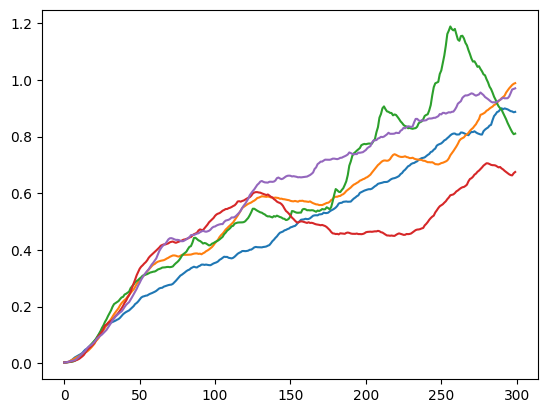

In [ ]:
for i in range(5):
  plt.plot(ema(llc_estimator.sample()['loss/trace'][i], 10)[0])
plt.show()

In [ ]:
llc_from_trace(llc_estimator.sample()['loss/trace'], 100)

74.34526085853577

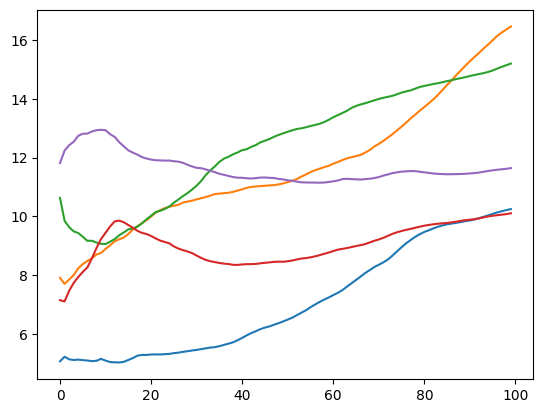

In [ ]:
for i in range(5):
  plt.plot(llc_estimator.sample()['llc/moving_avg'][i])
plt.show()

### plot full loss + llc curves

In [ ]:
llcs = get_llcs(model, ckpts, llc_loader)

KeyError: 'epochepoch0'

### Plotting single LLC trace (using own function)

In [ ]:
model = FCNet(dims=[40, 128, 2])
model.load_state_dict(ckpts['epoch0']['iter0']['model'])
train_set = ksparse_dataset(1024, 40, 3, ce=(PARAMS['loss_name']=='cross_entropy'))
llc_loader = DataLoader(train_set, batch_size=1024, shuffle=True)
llc, all_traces, all_losses, all_orig_losses, all_paths = estimate_llc(
    model, llc_loader,
    generator=None,
    epochs=1000,
    eps=1e-4,
    beta=100,
    gamma=0.9,
    chains=1,
    tq=True, ortho_grad=False,
    loss_fn=nn.CrossEntropyLoss(),
    warmup=0.05,
)

  0%|          | 0/1000 [00:00<?, ?it/s]

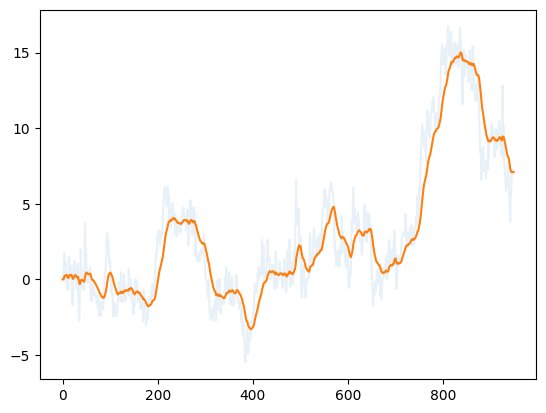

In [ ]:
plt.plot(all_traces[0], alpha=0.1)
plt.plot(ema(all_traces[0], 10)[0])
plt.show()

In [ ]:
llc

33.2927865460515

In [ ]:
from collections import defaultdict
llc_dict = defaultdict(list)
for eps in [1e-6, 1e-5, 1e-4, 1e-3, 1e-2]:
  for beta in [10, 100, 1000, 10_000]:
    llc_dict[beta].append(estimate_llc(
      model, llc_loader,
      generator=None,
      epochs=1000,
      eps=eps,
      beta=beta,
      gamma=0.5,
      chains=1,
      tq=True, ortho_grad=False,
      loss_fn=nn.CrossEntropyLoss(),
    )[0])

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

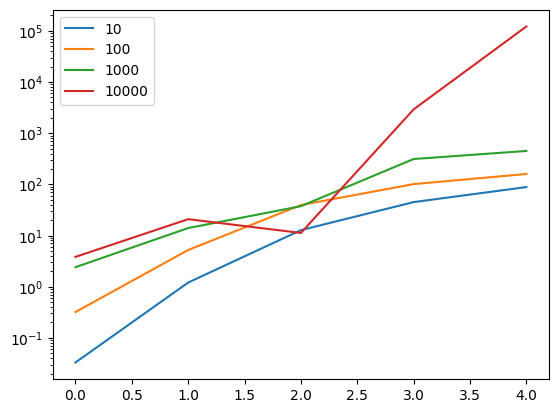

In [ ]:
for beta in llc_dict:
  plt.plot(llc_dict[beta], label=beta)
plt.legend()
plt.yscale('log')
plt.show()

In [ ]:
llc_dict

defaultdict(list,
            {10: [37.42257299646735,
              37.4225439876318,
              37.42257810384035,
              37.4225404933095,
              37.42258009314537],
             100: [37.42254027351737,
              37.42253526672721,
              37.422537729144096,
              37.42254174128175,
              37.42258033901453],
             1000: [37.42254129052162,
              37.42257729917765,
              37.42253955081105,
              37.42257819324732,
              37.42257738485932],
             10000: [37.422535333782434,
              37.42258071154356,
              37.42254155874252,
              37.42257481068373,
              37.422540698200464]})

### tuning training + task hyperparameters (no llc)

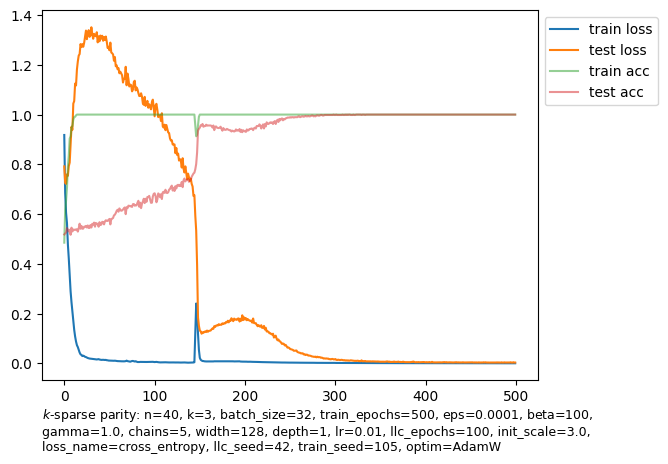

In [ ]:
fig, ax1 = plt.subplots()
lines = loss_acc_plot(train_losses, test_losses, train_accs, test_accs, yscale='linear', xscale='linear', ax=ax1)
plt.text(
    0, -0.2,
    '$k$-sparse parity: ' + ', '.join(f'{k}={v}' for k, v in PARAMS.items() if k not in [rows[0], cols[0]]),
    fontsize=9,
    ha='left',
    va='bottom',
    wrap=True,
    transform=ax1.transAxes
)
plt.legend(
    lines, ['train loss', 'test loss', 'train acc', 'test acc'],
    loc='upper left', bbox_to_anchor=(1.0, 1.0),
)
plt.show()

  0%|          | 0/49 [00:00<?, ?it/s]

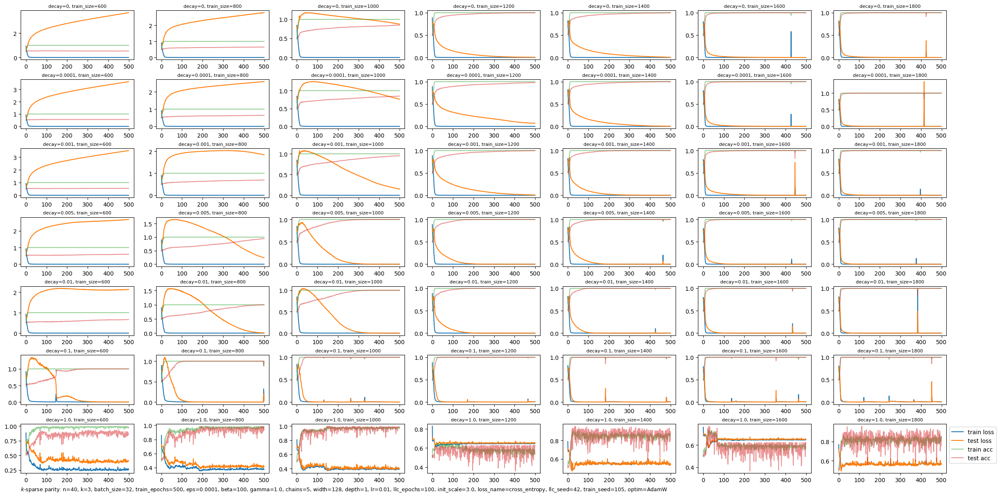

In [ ]:
from itertools import product

#rows = ('optim', ['SGD', 'Adam', 'AdamW'])
#rows = ('loss_name', ['cross_entropy', 'MSE', 'hinge'])
cols = ('train_size', list(range(600, 2000, 200)))
rows = ('decay', [0, 1e-4, 1e-3, 5e-3, 1e-2, 1e-1, 1.])
nrows = len(rows[1])
ncols = len(cols[1])
fig, axes = plt.subplots(nrows, ncols, figsize=(4*ncols, 2*nrows))
for (i, row_param), (j, col_param) in tqdm(product(enumerate(rows[1]), enumerate(cols[1])), total=len(rows[1]) * len(cols[1])):
  cur_params = {**PARAMS, **{rows[0]: row_param, cols[0]: col_param,}}# 'train_epochs': 5}}
  train_losses, test_losses, train_accs, test_accs, llc_traces, llcs, weight_norms, _ = run(**cur_params, tq=False)
  lines = loss_acc_plot(train_losses, test_losses, train_accs, test_accs, ax=axes[i, j])
  axes[i, j].set_title(f'{rows[0]}={row_param}, {cols[0]}={col_param}', fontsize=8)
#plt.suptitle('$k$-sparse parity')
plt.subplots_adjust(left=0.1, right=0.9, top=0.9, bottom=0.1, wspace=0.2, hspace=0.4)
plt.text(
    0, -0.4,
    '$k$-sparse parity: ' + ', '.join(f'{k}={v}' for k, v in PARAMS.items() if k not in [rows[0], cols[0]]),
    fontsize=9,
    ha='left',
    va='bottom',
    wrap=True,
    transform=axes[-1,0].transAxes
)
plt.legend(
    lines, ['train loss', 'test loss', 'train acc', 'test acc'],
    loc='upper left', bbox_to_anchor=(1.0, 1.0),
)
plt.show()


In [ ]:
np.array(llc_traces)[:,0,:].mean(axis=-1).shape

(50,)

In [ ]:
np.array(llc_traces)[-1,:,1450:].mean()

64.59969034534076

In [ ]:
len(llc_traces[0][0])

2900

### plot full loss curves + llc

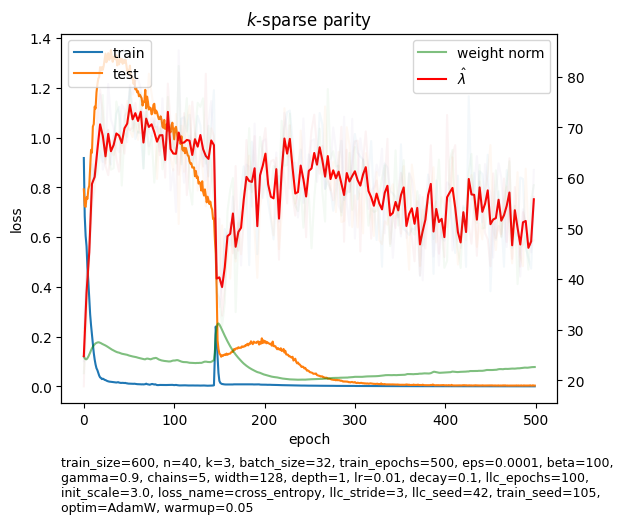

In [ ]:
fig, ax1 = plt.subplots()
plt.xlabel('epoch')
plt.ylabel('loss')
#plt.yscale('log')
ax2 = ax1.twinx()
ax1.plot(train_losses)
ax1.plot(test_losses)
#plt.yscale('linear')
ax2.plot(np.array(weight_norms), 'g', alpha=0.5)
#ax2.errorbar(range(0, 500, 4), llcs, yerr=ses, c='r', alpha=0.5)
#ax2.plot(range(0, 500, 4), ema(llcs, hl=10)[0], 'r', alpha=0.5)
#ax2.plot(range(0, 500, 4), gaussian_filter(llcs, sigma=1.), 'r', alpha=0.5)
ax2.plot(range(0, 500, PARAMS['llc_stride']), llcs, 'r')
for i in range(5):
  plt.plot(
      range(0, 500, PARAMS['llc_stride']),
      np.array(llc_traces)[:,i,int(0.5 * len(llc_traces[0][0])):].mean(axis=-1),
      alpha=0.05
  )

ax1.legend(['train', 'test'], loc='upper left')
ax2.legend(['weight norm', '$\hat\lambda$'], loc='upper right')
plt.title('$k$-sparse parity')
plt.text(
    0, -0.3,
    ', '.join(f'{k}={v}' for k, v in PARAMS.items()),
    fontsize=9,
    ha='left',
    va='bottom',
    wrap=True,
    transform=ax1.transAxes
)
#plt.title(','.join(f'{k}={v}' for k, v in PARAMS.items()), fontsize=8, wrap=True)
#plt.title('$k=3, n=,$train_size=1000,$ \\varepsilon=10^{-4}, n\\beta=100, \\gamma=1$, chains=5, SGLD_epochs=100', fontsize=8)
plt.show()

In [ ]:
globals().update(res_load)

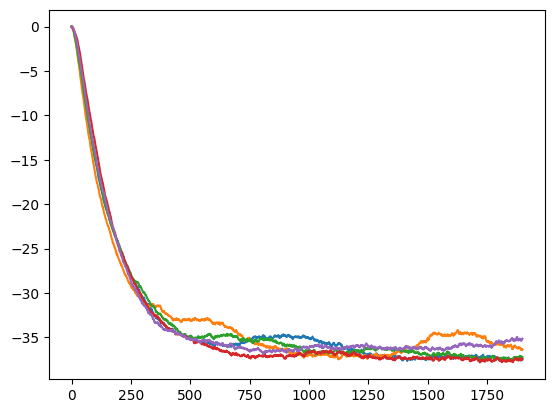

In [ ]:
for trace in llc_traces[0]:
  plt.plot(ema(trace, hl=100)[0])
  #plt.plot(trace)
plt.show()

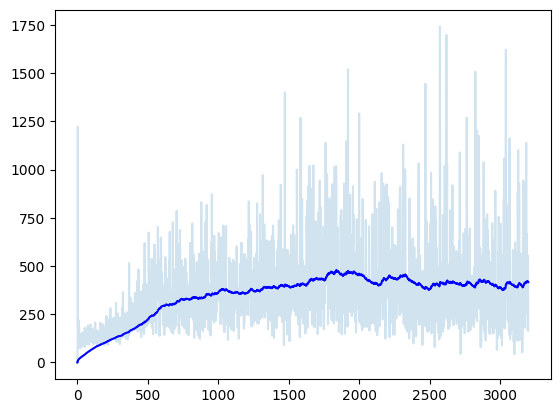

In [ ]:
plt.plot(llc_traces[-1], alpha=0.2)
plt.plot(ema(llc_traces[-1], hl=100)[0], c='b')
plt.show()

  0%|          | 0/200 [00:00<?, ?it/s]

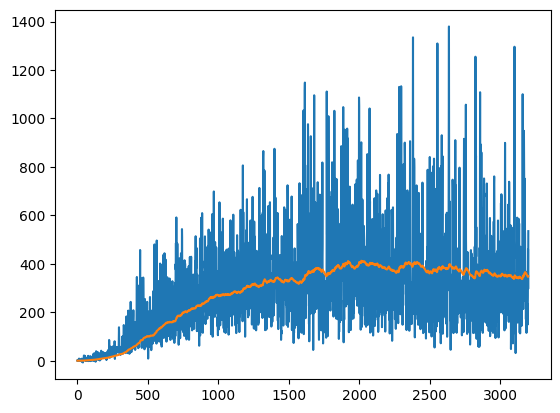

In [ ]:
|trace, losses, orig_losses, path = llc(model, train_loader, epochs=200, eps=1e-4, beta=100, gamma=1., tq=True)
plt.plot(trace)
plt.plot(ema(trace, hl=100)[0])
plt.show()

In [ ]:
np.mean(trace[1000:])

362.1883970526132

In [ ]:
ema(trace, hl=100)[0][-1]

348.33352302597075

  0%|          | 0/100 [00:00<?, ?it/s]

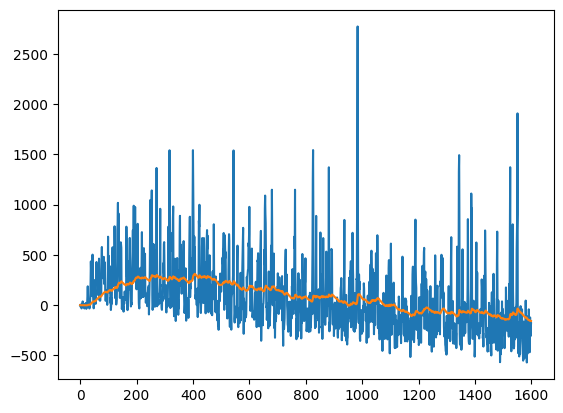

In [ ]:
trace, losses, orig_losses, path = llc(model, train_loader, epochs=100, eps=1e-4, beta=1000, gamma=1.0, tq=True, ortho_grad=False)
plt.plot(trace)
plt.plot(ema(trace, hl=50))
plt.show()

In [ ]:
ema(trace, hl=50)[-1]

93.39462453298528

In [ ]:
_, _, x, y = ksparse_loader(20, N, K, inds=INDS)

In [ ]:
x

tensor([[1., 1., 1., 1., 1., 1., 0., 1., 1., 0.],
        [1., 1., 0., 1., 1., 0., 0., 0., 0., 1.],
        [0., 0., 0., 1., 0., 1., 1., 0., 0., 0.],
        [1., 0., 1., 1., 0., 0., 1., 0., 1., 0.],
        [1., 0., 0., 0., 1., 0., 0., 1., 0., 0.],
        [1., 0., 0., 1., 0., 0., 0., 0., 1., 1.],
        [0., 1., 0., 0., 1., 0., 1., 1., 0., 0.],
        [1., 0., 1., 0., 0., 1., 0., 0., 0., 0.],
        [0., 1., 0., 1., 0., 1., 1., 1., 0., 0.],
        [0., 1., 1., 1., 1., 0., 0., 1., 1., 1.],
        [1., 1., 0., 1., 1., 0., 0., 0., 0., 1.],
        [1., 0., 0., 0., 1., 1., 1., 0., 0., 1.],
        [1., 0., 0., 1., 0., 0., 0., 0., 1., 0.],
        [1., 0., 1., 1., 1., 0., 1., 1., 0., 1.],
        [1., 0., 1., 0., 0., 0., 0., 1., 0., 0.],
        [0., 1., 1., 1., 0., 1., 0., 1., 0., 0.],
        [0., 0., 1., 1., 0., 1., 1., 1., 0., 1.],
        [1., 1., 0., 0., 0., 0., 1., 0., 0., 0.],
        [0., 0., 0., 0., 1., 1., 0., 1., 1., 0.],
        [0., 0., 0., 1., 0., 1., 1., 1., 0., 1.]],

In [ ]:
y

tensor([0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1],
       device='cuda:0')

In [ ]:
list(zip(model(x.to(device)).argmax(dim=1).cpu().numpy(), y.cpu().numpy()))

[(0, 0),
 (0, 0),
 (1, 1),
 (1, 1),
 (1, 1),
 (0, 0),
 (1, 1),
 (0, 0),
 (0, 0),
 (0, 0),
 (0, 0),
 (0, 0),
 (0, 0),
 (0, 0),
 (0, 0),
 (1, 1),
 (1, 1),
 (0, 0),
 (1, 1),
 (1, 1)]

In [ ]:
model(x)

tensor([[ 0.0000,  0.0000],
        [15.3525,  0.0000],
        [16.4730,  0.0000],
        [16.7129,  0.0000],
        [ 0.0000,  0.0000],
        [17.0406,  0.0000],
        [ 0.0000,  0.0000],
        [ 0.0000,  0.0000],
        [15.2370,  0.0000],
        [ 0.0000,  0.0000],
        [ 0.0000,  0.0000],
        [ 0.0000,  0.0000],
        [ 0.0000,  0.0000],
        [14.5162,  0.0000],
        [ 0.0000,  0.0000],
        [15.2815,  0.0000],
        [ 0.0000,  0.0000],
        [ 0.0000,  0.0000],
        [15.8399,  0.0000],
        [15.5705,  0.0000]], device='cuda:0', grad_fn=<ReluBackward0>)

## training dynamics analysis

In [ ]:
from glob import glob
glob('/content/drive/MyDrive/MATS/ksparse/n=40*')

['/content/drive/MyDrive/MATS/ksparse/n=40_k=3_width=128_depth=1_init_scale=3.0_train_size=1500_batch_size=32_train_epochs=500_lr=0.01_decay=0.005_optim=AdamW_loss_name=hinge_train_seed=105_save_ckpts=True.pt',
 '/content/drive/MyDrive/MATS/ksparse/n=40_k=3_width=128_depth=1_init_scale=3.0_train_size=1000_batch_size=32_train_epochs=500_lr=0.01_decay=0.005_optim=AdamW_loss_name=cross_entropy_train_seed=105_save_ckpts=True.pt',
 '/content/drive/MyDrive/MATS/ksparse/n=40_k=3_width=128_depth=1_init_scale=3.0_train_size=600_batch_size=32_train_epochs=500_lr=0.01_decay=0.1_optim=AdamW_loss_name=cross_entropy_train_seed=105_save_ckpts=True.pt']

In [ ]:
flat_ckpts = [
    ckpts[f'epoch{epoch}'][f'iter{iter}']
    for epoch in range(len(ckpts))
    for iter in range(len(ckpts[f'epoch{epoch}']))
]

In [ ]:
from glob import glob
file = glob('/content/drive/MyDrive/MATS/ksparse/*train_size=600*')[0]
ckpts = torch.load(file)

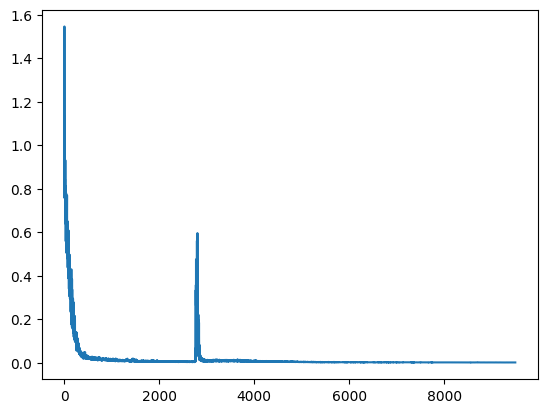

In [ ]:
plt.plot([flat_ckpts[i]['train_loss'] for i in range(len(flat_ckpts))])

In [ ]:
test_losses = []
model = FCNet(dims=[40, 128, 2])
test_set = ksparse_dataset(1024, 40, 3, ce=(PARAMS['loss_name']=='cross_entropy'))
test_loader = DataLoader(test_set, batch_size=1024, shuffle=False)
for i in tqdm(range(len(flat_ckpts))):
  model.load_state_dict(flat_ckpts[i]['model'])
  test_loss, test_acc = test_epoch(model, test_loader, loss_fn=loss_dict[PARAMS['loss_name']])
  test_losses.append(test_loss)

  0%|          | 0/9500 [00:00<?, ?it/s]

KeyboardInterrupt: 

In [ ]:
def plot_traj(ckpts):
  train_losses = [ckpt.train_loss for ckpt in ckpts]
  test_losses = [ckpt.test_loss for ckpt in ckpts]

In [ ]:
plt.plot(test_losses)

In [ ]:
train_losses = [flat_ckpts[i]['train_loss'] for i in range(len(flat_ckpts))]
weight_norms = dict()
grad_norms = dict()
m_norms = dict()
k_norms = dict()
norm = lambda x: torch.min(x.abs()).item() #lambda x: torch.norm(x).item() / x.numel()
weight_norms = {
    k: [norm(flat_ckpts[i]['model'][k]) for i in range(len(flat_ckpts))]
    for k in flat_ckpts[0]['model'].keys()
}
grad_norms = {
    k: [norm(flat_ckpts[i]['grads'][k]) for i in range(len(flat_ckpts))]
    for k in flat_ckpts[0]['grads'].keys()
}
m_norms = {
    k: [norm(flat_ckpts[i]['optimizer']['state'][j]['exp_avg']) for i in range(len(flat_ckpts))]
    for j, k in enumerate(flat_ckpts[0]['model'].keys())
}
v_norms = {
    k: [norm(flat_ckpts[i]['optimizer']['state'][j]['exp_avg_sq']) for i in range(len(flat_ckpts))]
    for j, k in enumerate(flat_ckpts[0]['model'].keys())
}
# step_norms = {
#     k: [norm(
#         flat_ckpts[i]['optimizer']['state'][j]['exp_avg'] / (flat_ckpts[i]['optimizer']['state'][j]['exp_avg_sq'].sqrt() + 1e-8)
#         ) for i in range(len(flat_ckpts))]
#     for j, k in enumerate(flat_ckpts[0]['model'].keys())
# }

In [ ]:
cos = lambda a, b: ((a * b).sum() / (a.norm() * b.norm())).item()

steps = {
    k: [flat_ckpts[i+1]['model'][k]-flat_ckpts[i]['model'][k]
        for i in range(len(flat_ckpts)-1)]
    for k in flat_ckpts[0]['model']
}
step_norms = {
    k: [norm(step) for step in steps[k]]
    for k in steps
}
step_aligns = {
    k: [cos(step, -flat_ckpts[i]['model'][k]) for i, step in enumerate(steps[k])]
    for k in steps
}

weight


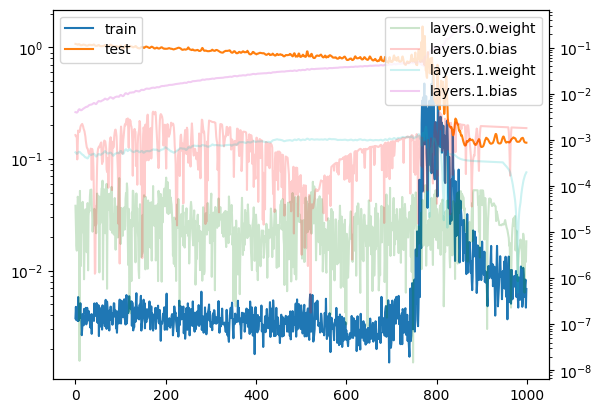

grad


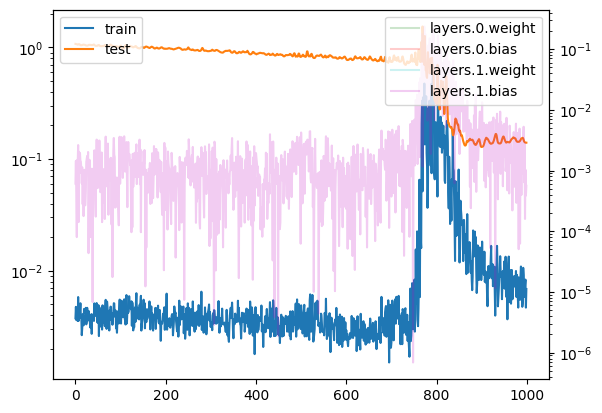

m


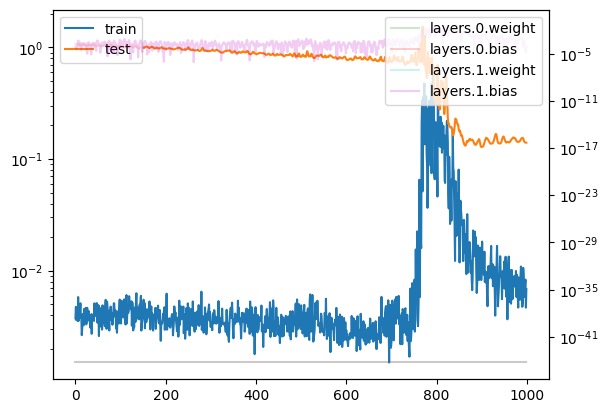

v


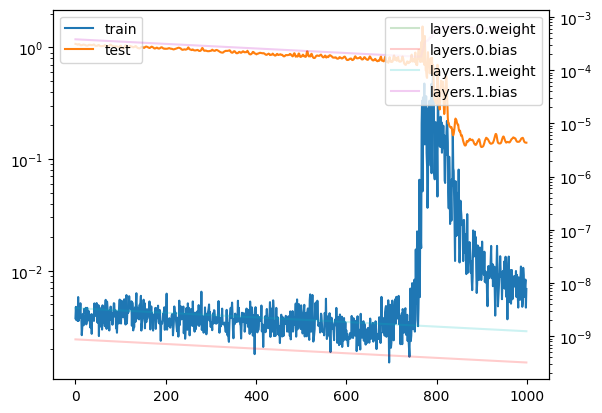

step


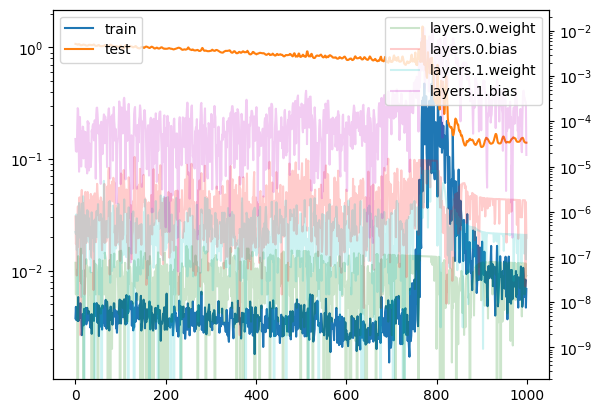

step_cos


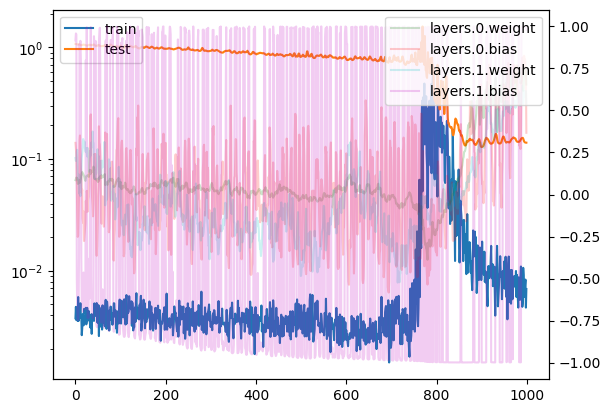

In [ ]:
all_norms = {
    'weight': weight_norms,
    'grad': grad_norms,
    'm': m_norms,
    'v': v_norms,
    'step': step_norms,
    'step_cos': step_aligns,
    # 'step': step_norms,
}
sl = slice(2700, 2)#slice(0, -1)#slice(9540, 9560)
for name, norms in all_norms.items():
  print(name)
  fig, ax1 = plt.subplots()
  ax1.set_yscale('log')

  ax1.plot(train_losses[sl], label='train')
  ax1.plot(test_losses[sl], label='test')
  ax2 = ax1.twinx()
  ax2.set_prop_cycle(color=['g', 'r', 'c', 'm'])
  for k in norms:
    ax2.plot(norms[k][sl], alpha=0.2, label=k)
  if 'cos' not in name:
    ax2.set_yscale('log')
  ax2.legend(loc='upper right')
  ax1.legend(loc='upper left')
  plt.show()

In [ ]:
import plotly.express as px

In [ ]:
px.imshow(1 / (flat_ckpts[8000]['optimizer']['state'][0]['exp_avg_sq'].detach().cpu().numpy() + 1e-10),)# interpolation='nearest', aspect='equal')
#px.colorbar()
#px.show()

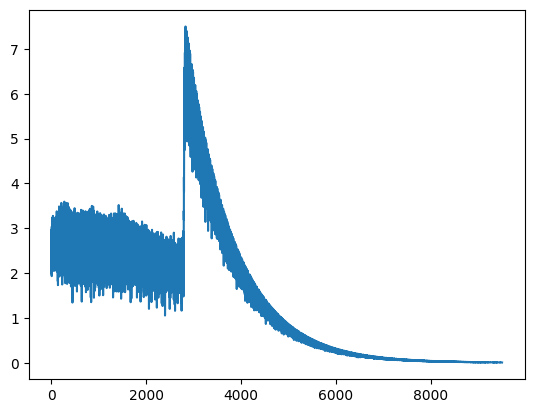

In [ ]:
acts = []
for i in range(len(flat_ckpts)):
  W0 = flat_ckpts[i]['model']['layers.0.weight']
  acts.append((W0 @ flat_ckpts[i]['train_x'].T)[103].abs().max().item())
plt.plot(acts)
plt.show()

In [ ]:
(W0 @ flat_ckpts[i]['train_x'].T).shape

torch.Size([128, 32])

In [ ]:
flat_ckpts[i]['train_x'].shape

torch.Size([32, 40])

In [ ]:
for j in range(0, 128):
  print(j)
  plt.plot(
      [flat_ckpts[i]['optimizer']['state'][0]['exp_avg_sq'][j,0].item() for i in range(2730, 2760)], alpha=0.7,#range(len(flat_ckpts))]    #range(2730, 2800)
  )
  plt.vlines(x=26, ymin=0, ymax=1e-3)
  plt.yscale('log')
  plt.ylim(1e-9, 1e-3)
  plt.show()

In [ ]:
# for j in range(128):
#   print(j)
#   for k in range(128):
#     plt.plot(
#         [flat_ckpts[i]['optimizer']['state'][0]['exp_avg_sq'][k,0].item() for i in range(2500, 2800)], alpha=0.5#range(len(flat_ckpts))]    #range(2730, 2800)
#     )
#   plt.plot(
#       [flat_ckpts[i]['optimizer']['state'][0]['exp_avg_sq'][j,0].item() for i in range(2500, 2800)], alpha=1., c='k',#range(len(flat_ckpts))]    #range(2730, 2800)
#   )
#   plt.yscale('log')
#   plt.show()

In [ ]:
((W0 @ flat_ckpts[i]['train_x'].T) > 0)

tensor([[ True,  True, False,  ..., False, False,  True],
        [False, False, False,  ..., False, False, False],
        [False, False, False,  ..., False, False, False],
        ...,
        [False, False, False,  ..., False, False, False],
        [False, False, False,  ..., False, False, False],
        [False, False, False,  ..., False, False, False]], device='cuda:0')

In [ ]:
acts.shape

(9500, 128)

In [ ]:
import pandas as pd
import plotly.express as px

acts = []
for i in range(1, len(flat_ckpts)):
  W0 = flat_ckpts[i-1]['model']['layers.0.weight']
  b0 = flat_ckpts[i-1]['model']['layers.0.bias'].reshape((-1, 1))
  acts.append(((W0 @ flat_ckpts[i]['train_x'].T + b0) > 0).sum(axis=-1).detach().cpu().numpy())
acts = np.array(acts)
acts = np.cumsum(acts, axis=0)
acts.shape

df = pd.DataFrame(acts)

df.columns = range(128)
df.index = range(len(flat_ckpts)-1)
fig = px.line(df)
fig.show()

# plt.plot(acts)
# plt.show()

/usr/local/lib/python3.10/dist-packages/plotly/express/_core.py:1223: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/usr/local/lib/python3.10/dist-packages/plotly/express/_core.py:1223: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/usr/local/lib/python3.10/dist-packages/plotly/express/_core.py:1223: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fr

In [ ]:
acts[0]

array([   4,   14,   34,   53,   67,   76,   85,  104,  115,  122,  136,
        145,  176,  181,  206,  220,  227,  236,  249,  276,  278,  308,
        333,  357,  362,  362,  366,  376,  398,  410,  423,  424,  429,
        447,  449,  469,  481,  484,  495,  511,  534,  561,  591,  615,
        637,  639,  647,  668,  692,  703,  714,  720,  729,  740,  742,
        771,  792,  812,  820,  844,  864,  892,  907,  923,  946,  960,
        990, 1003, 1033, 1063, 1094, 1105, 1135, 1137, 1150, 1176, 1200,
       1203, 1214, 1245, 1255, 1271, 1283, 1283, 1303, 1303, 1323, 1332,
       1352, 1368, 1377, 1378, 1398, 1405, 1422, 1430, 1462, 1463, 1477,
       1503, 1507, 1512, 1534, 1542, 1561, 1578, 1581, 1603, 1619, 1622,
       1649, 1650, 1653, 1657, 1683, 1713, 1742, 1747, 1776, 1799, 1813,
       1844, 1857, 1876, 1896, 1900, 1914, 1914])

In [ ]:
import pandas as pd

data = [
  [flat_ckpts[i]['optimizer']['state'][0]['exp_avg_sq'][j,0].item() for i in range(len(flat_ckpts))]
  for j in range(128)
]
data = np.array(data)

df = pd.DataFrame(data.T)  # Transpose the data for easier plotting

# Create x-axis values
x = np.arange(len(flat_ckpts))

# Melt the DataFrame to long format
df_melted = df.melt(ignore_index=False, var_name='line', value_name='y')
df_melted['x'] = df_melted.index

# Create the plot
fig = px.line(df_melted, x='x', y='y', color='line',)
fig.show()

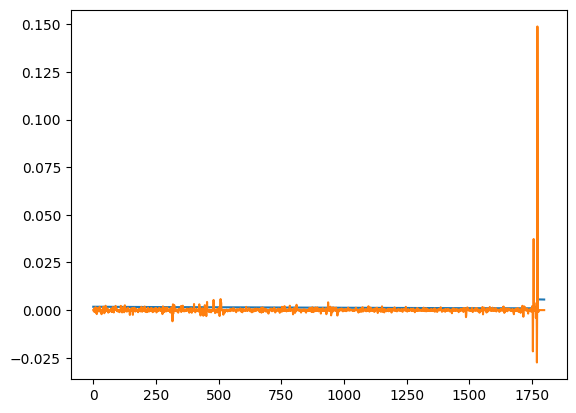

In [ ]:
ran = range(1000, 2800)
plt.plot(
  [flat_ckpts[i]['optimizer']['state'][0]['exp_avg_sq'][113,0].item()**0.5 for i in ran]
)
plt.plot(
  [flat_ckpts[i]['grads']['layers.0.weight'][113,0].item() for i in ran]
)
plt.show()

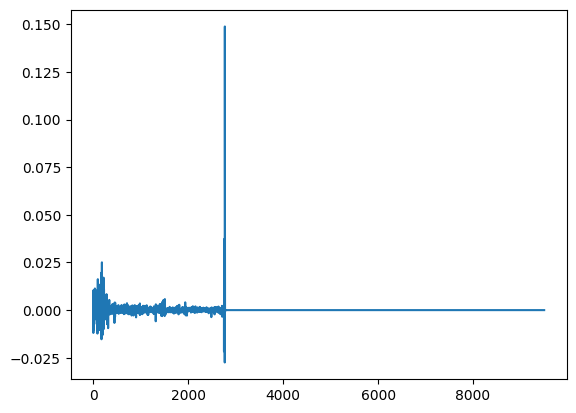

In [ ]:

plt.show()

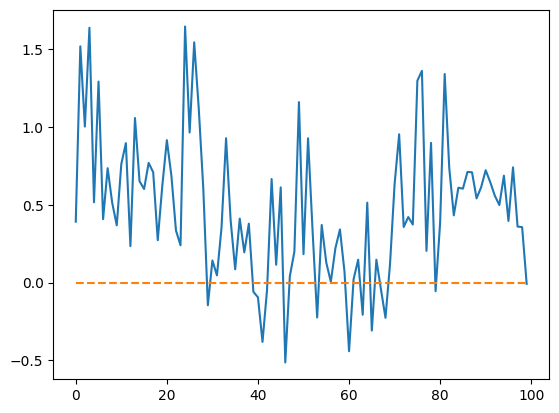

In [ ]:
plt.plot(
    [
        (flat_ckpts[i]['model']['layers.0.weight'][113,:] * flat_ckpts[i]['train_x']).sum(axis=-1).max().item()
        for i in range(100)#range(len(flat_ckpts))
    ]
)
plt.plot([0 for _ in range(100)], linestyle='dashed')
plt.show()

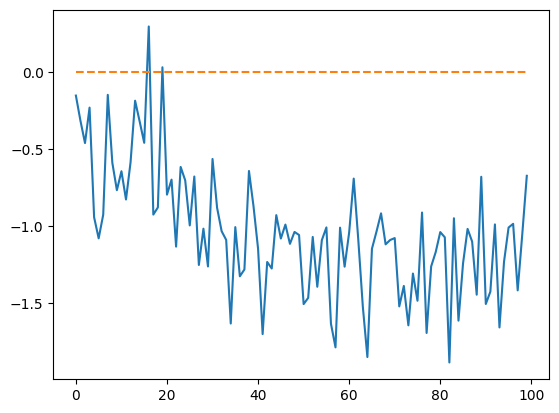

In [ ]:
plt.plot(
    [
        ((flat_ckpts[i]['model']['layers.0.weight'][85,:] * flat_ckpts[i]['train_x']).sum(axis=-1) + flat_ckpts[i]['model']['layers.0.bias'][85]).max().item()
        for i in range(100)#range(len(flat_ckpts))
    ]
)
plt.plot([0 for _ in range(100)], linestyle='dashed')
plt.show()

In [ ]:
(flat_ckpts[0]['model']['layers.0.weight'][85,:] * flat_ckpts[0]['train_x']).sum(axis=-1).max()

tensor(-0.0136, device='cuda:0')

In [ ]:
flat_ckpts[0]['train_x'].shape

torch.Size([32, 40])

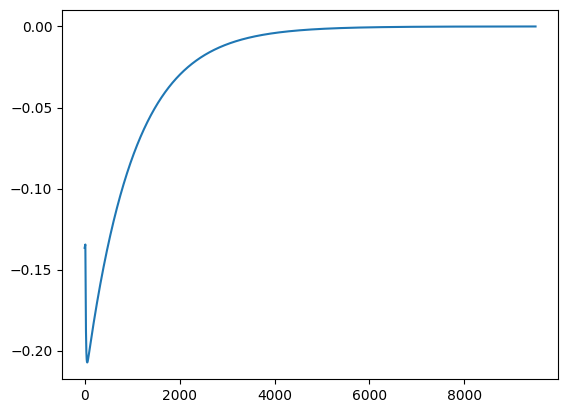

In [ ]:
plt.plot(
    [flat_ckpts[i]['model']['layers.0.bias'][85].item() for i in range(len(flat_ckpts))]
)

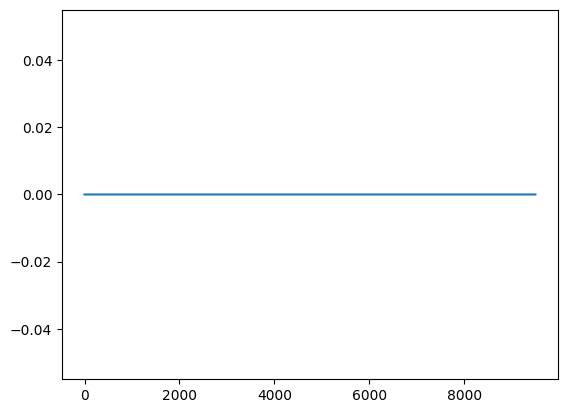

In [ ]:
plt.plot(
    [flat_ckpts[i]['grads']['layers.0.weight'][85,0].item() for i in range(len(flat_ckpts))]
)

In [ ]:
flat_ckpts[i].keys()

dict_keys(['model', 'optimizer', 'train_loss', 'train_x', 'train_y', 'train_out', 'grads'])

In [ ]:
flat_ckpts[0]['model'].keys()

odict_keys(['layers.0.weight', 'layers.0.bias', 'layers.1.weight', 'layers.1.bias'])

In [ ]:
len(test_losses)

500

In [ ]:
train_losses[9554:9570]

[1.8965452909469604e-05,
 0.0,
 0.0,
 0.0014053285121917725,
 0.0,
 0.0,
 0.07066274434328079,
 0.022530948743224144,
 0.11121387779712677,
 0.10052803158760071,
 0.052280984818935394,
 0.1953442245721817,
 0.07708825170993805,
 0.24836783111095428,
 0.19491389393806458,
 0.523841381072998]

In [ ]:
1500/32

46.875

In [ ]:
x, y, out = flat_ckpts[9554]['train_x'], flat_ckpts[9554]['train_y'], flat_ckpts[9554]['train_out']

In [ ]:
batch_losses = []
for i in range(9450, 9554):
  model.load_state_dict(flat_ckpts[i]['model'])
  batch_losses.append(hinge_loss(model(x), y).item())

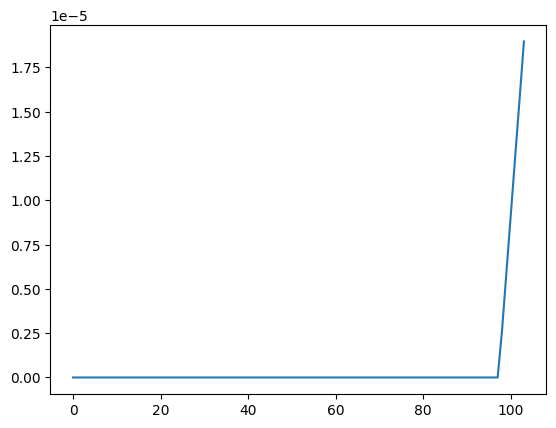

In [ ]:
plt.plot(batch_losses)

In [ ]:
hinge_loss(model(x), y)

tensor(1.8965e-05, device='cuda:0', grad_fn=<MeanBackward0>)

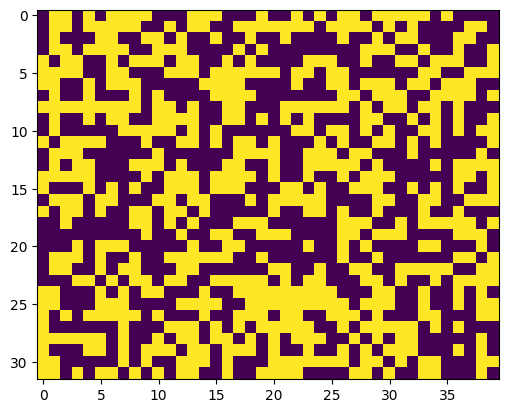

In [ ]:
plt.imshow(x.cpu().numpy())

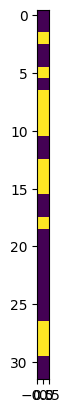

In [ ]:
plt.imshow(y.cpu().numpy().reshape((-1, 1)))

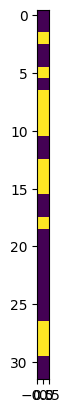

In [ ]:
plt.imshow((out > 0).detach().cpu().numpy().reshape((-1, 1)))

In [ ]:
y.shape

torch.Size([32])

In [ ]:
out.flatten().sign() != y.sign()

tensor([False, False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False, False,
        False, False], device='cuda:0')

In [ ]:
out.flatten()

tensor([-5.6223, -4.1157,  4.9484, -3.3242, -2.5358,  7.3998, -5.9200,  3.7460,
         5.5210,  3.5742,  0.9994, -3.9015, -4.2258,  2.9062,  5.8339, 10.0845,
        -3.2606, -4.3845,  2.8728, -6.4509, -5.5928, -5.6171, -4.2290, -2.5488,
        -4.7418, -3.5121, -2.2752,  3.9837,  5.4764,  2.0976, -4.8288, -2.9889],
       device='cuda:0', grad_fn=<ViewBackward0>)

In [ ]:
hinge_loss(out, y)

tensor(1.8965e-05, device='cuda:0', grad_fn=<MeanBackward0>)

In [ ]:
flat_ckpts[9000]['optimizer']['state'][0]['exp_avg']

tensor([[-5.6052e-45, -5.6052e-45,  5.6052e-45,  ..., -5.6052e-45,
          5.6052e-45,  5.6052e-45],
        [-5.6052e-45,  5.6052e-45, -5.6052e-45,  ...,  5.6052e-45,
         -5.6052e-45,  5.6052e-45],
        [ 5.6052e-45,  5.6052e-45, -5.6052e-45,  ...,  5.6052e-45,
         -5.6052e-45,  5.6052e-45],
        ...,
        [ 5.6052e-45, -5.6052e-45,  5.6052e-45,  ..., -5.6052e-45,
          5.6052e-45, -5.6052e-45],
        [ 5.6052e-45, -5.6052e-45,  5.6052e-45,  ..., -5.6052e-45,
          5.6052e-45, -5.6052e-45],
        [-5.6052e-45,  5.6052e-45,  5.6052e-45,  ..., -5.6052e-45,
         -5.6052e-45,  5.6052e-45]], device='cuda:0')

In [ ]:
plt.imshow(flat_ckpts[7000])

In [ ]:
flat_ckpts[0]['model'].keys()

odict_keys(['layers.0.weight', 'layers.0.bias', 'layers.1.weight', 'layers.1.bias'])

In [ ]:
train_loader_gen = torch.Generator(device='cpu')
train_gen = torch.Generator(device=device)
train_loader_gen.manual_seed(105)
train_gen.manual_seed(105)
train_set = ksparse_dataset(1500, 40, 3, pm=True, generator=train_gen)
train_loader = DataLoader(train_set, batch_size=1500, shuffle=False, generator=train_loader_gen)

In [ ]:
x, y = next(iter(train_loader))

<All keys matched successfully>

In [ ]:
hinge_loss(model(x), y)

tensor(0., device='cuda:0', grad_fn=<MeanBackward0>)

In [ ]:
model.eval()
model.load_state_dict(flat_ckpts[8000]['model'])
for _ in tqdm(range(1_000_000)):
  for _, param in model.named_parameters():
    param.requires_grad = False
    noise = torch.randn_like(param)
    noise = 1e-4 * noise / (torch.norm(noise) + 1e-8)
    param += noise
  assert hinge_loss(model(x), y).item() == 0

  0%|          | 0/1000000 [00:00<?, ?it/s]

In [ ]:
model = FCNet(dims=[40, 128, 1])
model.load_state_dict(flat_ckpts[8000]['model'])


<All keys matched successfully>

In [ ]:
def show_weights(model):
  for name, param in model.named_parameters():
    print(name)
    p = param.detach().cpu().numpy()
    print(p.shape)
    if len(p.shape) == 1:
      if p.shape[0] == 1:
        print(p.item())
        continue
      p = p.reshape((-1, 1))
    plt.figure(figsize=(12, 8))
    plt.imshow(p, interpolation='nearest', aspect='equal')
    plt.show()

layers.0.weight
(128, 40)


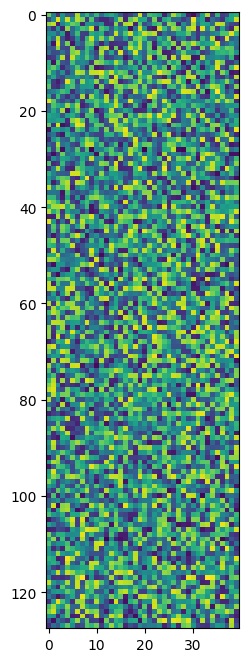

layers.0.bias
(128,)


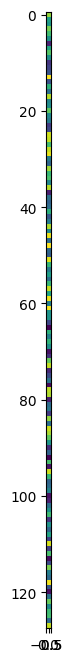

layers.1.weight
(2, 128)


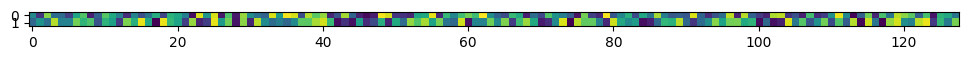

layers.1.bias
(2,)


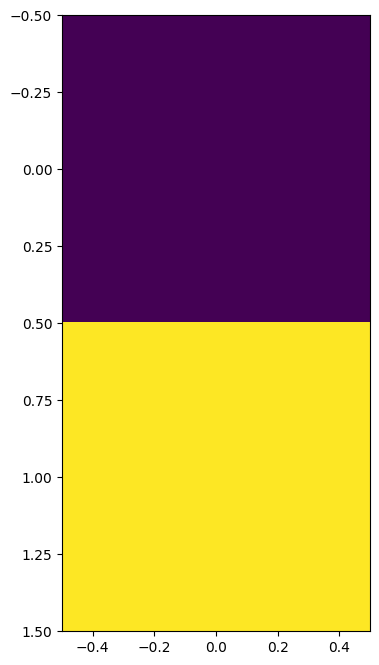

In [ ]:
model.load_state_dict(flat_ckpts[5]['model'])
show_weights(model)

layers.0.weight
(128, 40)


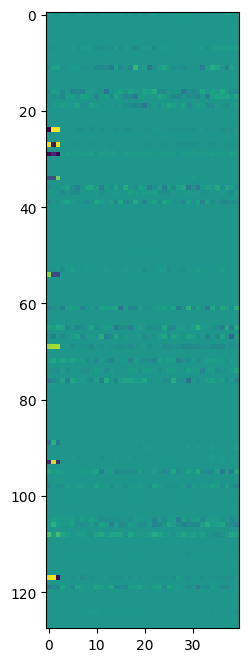

layers.0.bias
(128,)


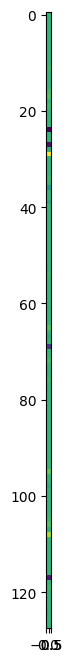

layers.1.weight
(2, 128)


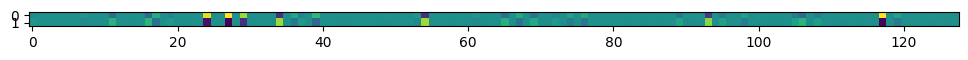

layers.1.bias
(2,)


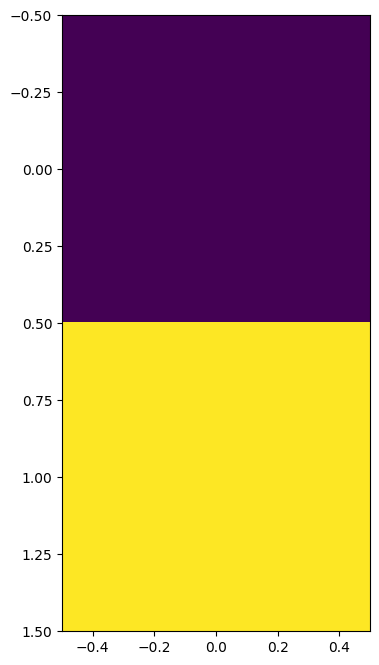

In [ ]:
model.load_state_dict(flat_ckpts[-1]['model'])
show_weights(model)

In [ ]:
#neurons = [39,80,81]
W0 = model.get_parameter('layers.0.weight').data.clone()
b0 = model.get_parameter('layers.0.bias').data.reshape((-1, 1)).clone()
W1 = model.get_parameter('layers.1.weight').data.clone()
b1 = model.get_parameter('layers.1.bias').data.reshape((-1, 1)).clone()

In [ ]:
W0.requires_grad = True
b0.requires_grad = True
W1.requires_grad = True
b1.requires_grad = True

In [ ]:
x, y = next(iter(test_loader))
x = x[0].reshape((-1, 1))
y = y[0]

In [ ]:
out = b1 + W1 @ (nn.ReLU()(b0 + W0 @ x))
loss = torch.log(out[0])
loss.backward()

In [ ]:
out

tensor([[ 4.4543],
        [-4.4563]], device='cuda:0', grad_fn=<AddBackward0>)

In [ ]:
px.imshow(W0.grad.detach().cpu().numpy())

In [ ]:
W1.abs().min()

tensor(4.6096e-07, device='cuda:0', grad_fn=<MinBackward1>)

In [ ]:
px.imshow(W1.detach().cpu().numpy())

In [ ]:
x.shape

torch.Size([40, 1])

In [ ]:
W1 @ nn.ReLU()(b0 + W0 @ x)

tensor([[ 4.5285],
        [-4.5304]], device='cuda:0')

In [ ]:
b1.shape

torch.Size([2])

## Slingshot bias

In [ ]:
def do_random_jump(
    model, ckpts, train_loader, test_loader, optimizer, sshot, lag=5,
    loss_fn=nn.CrossEntropyLoss(), cont=None,
):
  '''
  Gets test loss from taking a random jump right before a slingshot
  (and then allowing training loss to converge)
  '''
  # First, do random jump at step sshot[0]-lag of size (model[max_train_step] - model[sshot[0]-lag])
  max_train_step = max(range(sshot[0], sshot[1]), key=lambda x: ckpts[x]['train_loss'])
  jump_size = {
      k: torch.norm(ckpts[max_train_step]['model'][k]-ckpts[sshot[0]-lag]['model'][k]).item() #/ np.sqrt(torch.numel(ckpts[0]['model'][k]))
      for k in ckpts[max_train_step]['model']
  }
  jumped_ckpt = deepcopy(ckpts[sshot[0]-lag]['model'])
  for k in jumped_ckpt:
    jump = torch.randn_like(jumped_ckpt[k])
    jumped_ckpt[k] += jump / jump.norm() * jump_size[k]
  # Then, keep training for another (sshot[1] - max_train_step) + cont steps
  jumped_ckpts = []
  model.load_state_dict(jumped_ckpt)
  width = sshot[1] - sshot[0]
  cont = width if cont is None else cont
  for epochs in range(
    (cont + sshot[1] - max_train_step) // len(train_loader) + 1
  ):
    jumped_ckpts.extend(train_epoch(model, train_loader, optimizer, loss_fn=loss_fn).ckpts)
  # Finally, compute test loss difference
  for i in range(sshot[0] - width, sshot[0]):
    populate_test(model, ckpts[i], test_loader=test_loader, loss_fn=loss_fn)
  for ckpt in jumped_ckpts:
    populate_test(model, ckpt, test_loader=test_loader, loss_fn=loss_fn)
  pre_loss = np.median([ckpts[i].test_loss for i in range(sshot[0] - width, sshot[0])])
  post_loss = np.median([ckpt.test_loss for ckpt in jumped_ckpts[-cont:]])
  return (pre_loss, post_loss), ckpts[:sshot[0]-lag] + jumped_ckpts


In [ ]:
def get_sshot_losses(
    model, ckpts, test_loader,
    sshots=None, loss_fn=nn.CrossEntropyLoss(), thresh_low=1e-2, thresh_high=1e-1
):
  '''
  Returns list of (pre sshot loss, post sshot loss)
  pre is interval before sshot of same width
  post is interval after sshot of same width
  '''
  if sshots is None:
    sshots = sshot_intervals(ckpts, thresh_low=thresh_low, thresh_high=thresh_high)
  losses = []
  for a, b in sshots:
    width = b - a
    pre = range(a - width, a)
    post = range(b + 1, b + width + 1)
    for i in list(pre) + list(post):
      populate_test(model, ckpts[i], test_loader=test_loader, loss_fn=loss_fn)
    # import pdb; pdb.set_trace()
    pre_loss = np.median([ckpts[i].test_loss for i in pre])
    post_loss = np.median([ckpts[i].test_loss for i in post])
    losses.append((pre_loss, post_loss))
  return losses

In [ ]:
def sshot_sweep(seeds=range(100), sshots_l=None, rand_jump=False):
  sshot_losses = []
  if not sshots_l:
    sshots_l = [None] * len(seeds)
  for i, seed in tqdm(enumerate(seeds), total=len(seeds)):
    runner = Runner(train_seed=seed, ckpt_lite=False)
    ckpts = runner.run(
        norm_stride=None,
        test_stride=10,
        llc_stride=None,
        anom_delta=1000,
        save_ckpts=False,
        force_regen=True,
        tq=False,
    )
    if sshots_l[i] is None:
      sshots_l[i] = sshot_intervals(ckpts)
    if rand_jump:
      cur_losses = []
      for sshot in sshots_l[i]:
        cur_losses.append(do_random_jump(
            runner.model, ckpts, runner.train_loader, runner.test_loader, runner.optimizer, sshot,
        )[0])
    else:
      cur_losses = get_sshot_losses(runner.model, ckpts, runner.test_loader, sshots=sshots_l[i])
    sshot_losses.append(cur_losses)
  return sshots_l, sshot_losses

In [ ]:
from scipy.stats import median_test
def sshot_delta_hist(losses):
  '''
  losses should be a dict of {name: [(pre_loss, post_loss)]}
  '''
  ratios = {
      k: [np.log(b / a) for a, b in sum(v, [])]
      for k, v in losses.items()
  }
  avgs = {
      k: np.median(v)
      for k, v in ratios.items()
  }
  pvalues = {
      k: median_test(ratios['sshot'], ratios[k]).pvalue
      for k, v in ratios.items() #if k != 'sshot'
  }
  df = pd.DataFrame(dict(
      data=np.concatenate(list(ratios.values())),
      series=sum([
          [f'{k} (median={avgs[k]:.2f}, p={pvalues[k]:.2f})'] * len(v) for k, v in ratios.items()
      ], []),
  ))
  fig = px.histogram(df, barmode='overlay', color='series')
  fig.update_xaxes(title_text='slingshot log loss ratios')
  title = 'k-sparse slingshot loss ratios'
  fig.update_layout(title=f'k-sparse slingshots')
  return fig

In [ ]:
N = 100
sshots_l, sshot_losses = sshot_sweep(seeds=range(N))
# these sshot intervals intentionally do not match up with the seeds
# the point is to get loss diffs from intervals without sshots, as a baseline for comparison
_, no_sshot_losses = sshot_sweep(seeds=range(N, 2*N), sshots_l=sshots_l)

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

In [ ]:
with open(f'{prefix}/ksparse/sshots.pkl', 'wb') as f:
  pickle.dump((sshots_l, sshot_losses, no_sshot_losses), f)

In [ ]:
_, rand_jump_losses = sshot_sweep(seeds=range(N), rand_jump=True)

  0%|          | 0/100 [00:00<?, ?it/s]

In [ ]:
with open(f'{prefix}/ksparse/rand_jump_losses.pkl', 'wb') as f:
  pickle.dump(rand_jump_losses, f)

In [ ]:
losses = {
    'sshot': sshot_losses,
    'no_sshot': no_sshot_losses,
    'rand_jump': rand_jump_losses,
}
fig = sshot_delta_hist(losses)
params = clean_params(Runner().get_params())
params['sshot_seeds'] = '0-99'
params['no_sshot_seeds'] = '100-199'
params.pop('train_seed')
fig = add_params(fig, params, y=-.22, width=250)
fig.show()

In [ ]:
sshots_l, sshot_losses, no_sshot_losses = pickle.load(open(f'{prefix}/ksparse/sshots.pkl', 'rb'))

In [ ]:
pickle.load(open(f'{prefix}/ksparse/rand_jump_losses.pkl', 'rb'))

[[],
 (0.2952166795730591, 0.09780701249837875),
 (0.011944737285375595, 0.03909659758210182)]

### plotting some random jumps

In [ ]:
sshots = sshot_intervals(ckpts)

In [ ]:
_, jumped_ckpts = do_random_jump(
    runner.model, ckpts, runner.train_loader, runner.test_loader, runner.optimizer, sshots[0], cont=1000,
)

In [ ]:
for i in tqdm(range(len(ckpts))):
  populate_test(runner.model, ckpts[i], test_loader=runner.test_loader, loss_fn=nn.CrossEntropyLoss())

  0%|          | 0/9500 [00:00<?, ?it/s]

In [ ]:
ckpts_dict = {
    'orig': [ckpt.test_loss for ckpt in ckpts[:len(jumped_ckpts)]],
}
for i in tqdm(range(10)):
  jump_losses, jumped_ckpts = do_random_jump(
      runner.model, ckpts, runner.train_loader, runner.test_loader, runner.optimizer, sshots[0], cont=1000,
  )
  for j in (range(len(jumped_ckpts))):
    populate_test(runner.model, jumped_ckpts[j], test_loader=runner.test_loader, loss_fn=nn.CrossEntropyLoss())
  ckpts_dict[f'jump_{i}'] = [ckpt.test_loss for ckpt in jumped_ckpts]

  0%|          | 0/10 [00:00<?, ?it/s]

In [ ]:
df = pd.DataFrame(ckpts_dict)
fig = px.line(df)
cmap = plt.get_cmap('jet')
for i in range(10):
  color_str = ','.join(map(lambda c: str(int(255*c)), cmap(i/10)[:3]))
  fig.update_traces(line=dict(color=f'rgba({color_str},0.2)'), selector=dict(name=f'jump_{i}'))
fig.update_traces(line=dict(color='black'), selector=dict(name='orig'))
fig.update_xaxes(title_text='iter')
fig.update_yaxes(title_text='test loss')
fig.show()